# Assignment - 1


# Image Stitching

# Preprocessing

Histogram Equalization, CLAHE and Fuzzy Logic Contrast Enhancement

In [ ]:
import math

import cv2
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display, Markdown
from glob2 import glob

# Gaussian Function:
def G(x, mean, std):
    return np.exp(-0.5*np.square((x-mean)/std))

# Membership Functions:
def ExtremelyDark(x, M):
    return G(x, -50, M/6)

def VeryDark(x, M):
    return G(x, 0, M/6)

def Dark(x, M):
    return G(x, M/2, M/6)

def SlightlyDark(x, M):
    return G(x, 5*M/6, M/6)

def SlightlyBright(x, M):
    return G(x, M+(255-M)/6, (255-M)/6)

def Bright(x, M):
    return G(x, M+(255-M)/2, (255-M)/6)

def VeryBright(x, M):
    return G(x, 255, (255-M)/6)

def ExtremelyBright(x, M):
    return G(x, 305, (255-M)/6)

for M in (128, 64, 192):
    x = np.arange(-50, 306)
    
    ED = ExtremelyDark(x, M)
    VD = VeryDark(x, M)
    Da = Dark(x, M)
    SD = SlightlyDark(x, M)
    SB = SlightlyBright(x, M)
    Br = Bright(x, M)
    VB = VeryBright(x, M)
    EB = ExtremelyBright(x, M)
def OutputFuzzySet(x, f, M, thres):
    x = np.array(x)
    result = f(x, M)
    result[result > thres] = thres
    return result

def AggregateFuzzySets(fuzzy_sets):
    return np.max(np.stack(fuzzy_sets), axis=0)

def Infer(i, M, get_fuzzy_set=False):
    # Calculate degree of membership for each class
    VD = VeryDark(i, M)
    Da = Dark(i, M)
    SD = SlightlyDark(i, M)
    SB = SlightlyBright(i, M)
    Br = Bright(i, M)
    VB = VeryBright(i, M)
    
    # Fuzzy Inference:
    x = np.arange(-50, 306)
    Inferences = (
        OutputFuzzySet(x, ExtremelyDark, M, VD),
        OutputFuzzySet(x, VeryDark, M, Da),
        OutputFuzzySet(x, Dark, M, SD),
        OutputFuzzySet(x, Bright, M, SB),
        OutputFuzzySet(x, VeryBright, M, Br),
        OutputFuzzySet(x, ExtremelyBright, M, VB)
    )
    
    # Calculate AggregatedFuzzySet:
    fuzzy_output = AggregateFuzzySets(Inferences)
    
    # Calculate crisp value of centroid
    if get_fuzzy_set:
        return np.average(x, weights=fuzzy_output), fuzzy_output
    return np.average(x, weights=fuzzy_output)

import glob
# Proposed fuzzy method
def FuzzyContrastEnhance(rgb):
    # Convert RGB to LAB
    lab = cv2.cvtColor(rgb, cv2.COLOR_RGB2LAB)
    
    # Get L channel
    l = lab[:, :, 0]
    
    # Calculate M value
    M = np.mean(l)
    if M < 128:
        M = 127 - (127 - M)/2
    else:
        M = 128 + M/2
        
    # Precompute the fuzzy transform
    x = list(range(-50,306))
    FuzzyTransform = dict(zip(x,[Infer(np.array([i]), M) for i in x]))
    
    # Apply the transform to l channel
    u, inv = np.unique(l, return_inverse = True)
    l = np.array([FuzzyTransform[i] for i in u])[inv].reshape(l.shape)
    
    # Min-max scale the output L channel to fit (0, 255):
    Min = np.min(l)
    Max = np.max(l)
    lab[:, :, 0] = (l - Min)/(Max - Min) * 255
    
    # Convert LAB to RGB
    return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)

# Traditional method of histogram equalization
def HE(rgb):
    lab = cv2.cvtColor(rgb, cv2.COLOR_RGB2LAB)
    lab[:, :, 0] = cv2.equalizeHist(lab[:, :, 0])
    return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)

# Contrast Limited Adaptive Histogram Equalization
def CLAHE(rgb):
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
    lab = cv2.cvtColor(rgb, cv2.COLOR_RGB2LAB)
    lab[:, :, 0] = clahe.apply(lab[:, :, 0])
    return cv2.cvtColor(lab, cv2.COLOR_LAB2RGB)


Double Plateau Historgam Equalization

In [2]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import glob
from past.builtins import xrange

def cal_t_up(hist, window_size):
    POLAR = []
    for i in range(0, len(hist) - window_size):
        window = hist[i : i + window_size]
        middle = window[(window_size + 1) // 2]
        if middle == max(window):
            POLAR.append(middle)
    return int(sum(POLAR)/len(POLAR))

def cal_t_low(hist, T_up):
    N = sum(hist)
    L = len(list(filter(lambda x : x != 0, hist)))
    print(L)
    return int(min(N, T_up * L)/256)

def thresholding(hist, T_up, T_low):
    new_hist = []
    for p_k in hist:
        if p_k > T_up:
            new_hist.append(T_up)
        elif T_up >= p_k and T_low <= p_k:
            new_hist.append(int(p_k))
        elif p_k <= T_low and p_k > 0:
            new_hist.append(T_low)
        elif p_k == 0:
            new_hist.append(0)
    return new_hist

def equlilize_img(hist, img):
     
    cs = np.cumsum(hist)

    nj = (cs - cs.min()) * 255
    N = cs.max() - cs.min()

    cs = nj / N
    cs = cs.astype('uint8')

    new_img = cs[img.ravel()]
    new_img = np.reshape(new_img, img.shape)

    return new_img

212


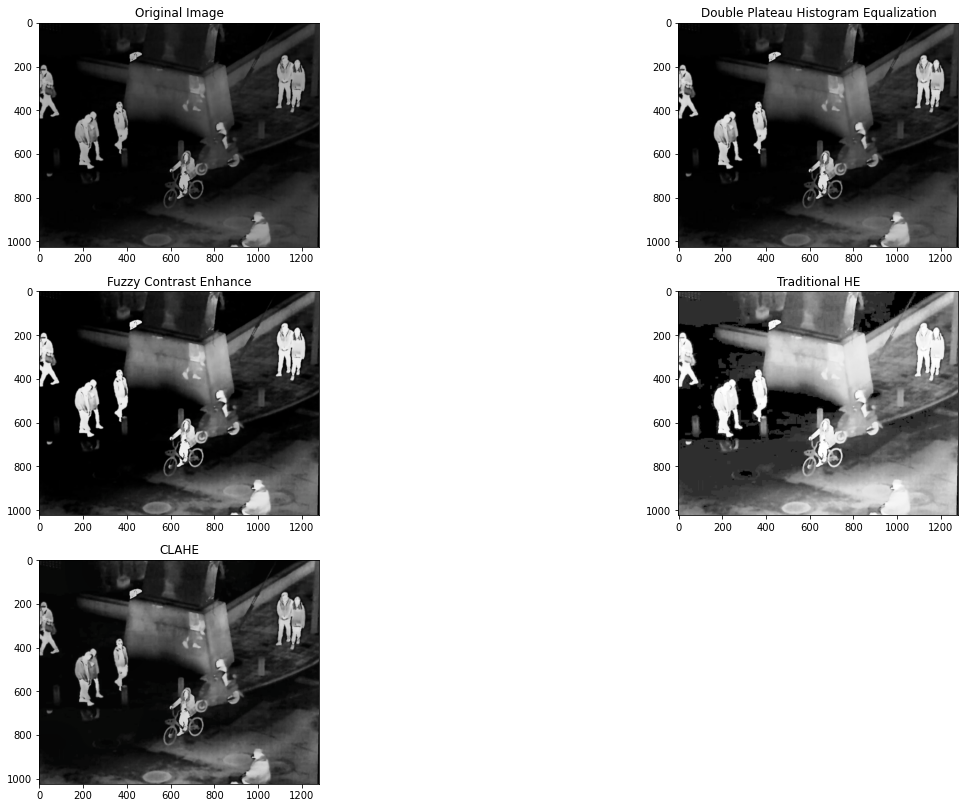

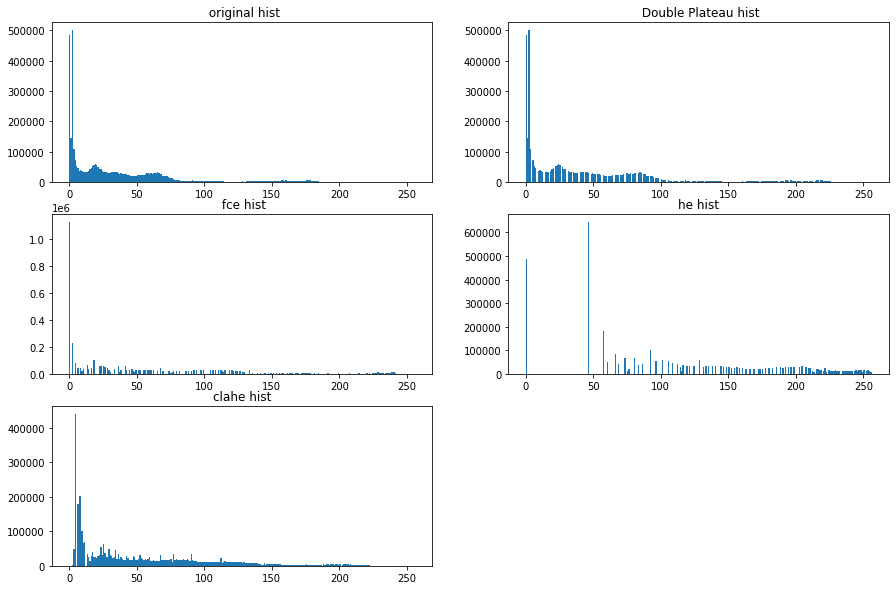

In [ ]:
gray_img = cv2.imread('/content/drive/MyDrive/IR_sample_assignment/LLVIP/010018.jpg')
hist = cv2.calcHist([gray_img], [0], None, [256], [0, 256])
T_up = cal_t_up(hist, 5)
T_low = cal_t_low(hist, T_up)
new_hist = thresholding(hist, T_up, T_low)
dphe_img = equlilize_img(new_hist, gray_img)

fce = FuzzyContrastEnhance(gray_img)
he = HE(gray_img)
clahe = CLAHE(gray_img) 

plt.figure(figsize=(21, 14))
plt.subplot(3, 2, 1)
plt.imshow(gray_img, cmap='gray')
plt.title('Original Image')

plt.subplot(3, 2, 2)
plt.imshow(dphe_img, cmap='gray')
plt.title('Double Plateau Histogram Equalization')

plt.subplot(3, 2, 3)
plt.imshow(fce)
plt.title('Fuzzy Contrast Enhance')

plt.subplot(3, 2, 4)
plt.imshow(he)
plt.title('Traditional HE')

plt.subplot(3, 2, 5)
plt.imshow(clahe)
plt.title('CLAHE')

plt.figure(figsize=(15, 10))
plt.subplot(3, 2, 1)
plt.hist(gray_img.ravel(),256,[0,256])
plt.title(' original hist')

plt.subplot(3, 2, 2)
plt.hist(dphe_img.ravel(),256,[0,256])
plt.title(' Double Plateau hist')


plt.subplot(3, 2, 3)
plt.hist(fce.ravel(),256,[0,256])
plt.title(' fce hist')

plt.subplot(3, 2, 4)
plt.hist(he.ravel(),256,[0,256])
plt.title('he hist')

plt.subplot(3, 2, 5)
plt.hist(clahe.ravel(),256,[0,256])
plt.title('clahe hist')

plt.show()

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# Dominant Frame Selection

In [ ]:
import glob
imdir1 = '/content/drive/MyDrive/IR_sample/FLIR_ADAS_v2/'

ext = ['jpg']
files1 = []

[files1.extend(glob.glob(imdir1 + '*.' + e)) for e in ext]
files1.sort()
k=[[]]
p=1
while p<len(files1):
  j=0
  while j<len(files1):
     
  # test image
    image = cv2.imread(files1[p])

    gray_image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    histogram = cv2.calcHist([gray_image], [0],
                            None, [256], [0, 256])
  
  # data1 image
    image= cv2.imread(files1[j])
    gray_image1 = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
    histogram1 = cv2.calcHist([gray_image1], [0],
                              None, [256], [0, 256])
  
    c1, c2 = 0, 0
  
  # Euclidean Distance between data1 and test
    i = 0
    while i<len(histogram) and i<len(histogram1):
        c1+=(histogram[i]-histogram1[i])**2
        i+= 1
    c1 = c1**(1 / 2)
  
    k[p-1].append(c1[0])
    j=j+1
  p=p+1
  k.append([c1[0]])
  
final=[]
for i in k:
  final.append(sum(i))

In [ ]:
final

[378481.578125,
 432218.9714355469,
 445259.4851074219,
 385759.80419921875,
 380214.8135986328,
 380075.51623535156,
 422257.8076171875,
 498384.2077636719,
 510305.4685058594,
 605652.8056640625,
 615615.3559570312,
 602119.8354492188,
 517198.982421875,
 399212.8828125,
 439486.431640625,
 448841.328125,
 533454.7973632812,
 537242.0366210938,
 413819.0146484375,
 0.0]

# Feature Matching

BRISK or ORB

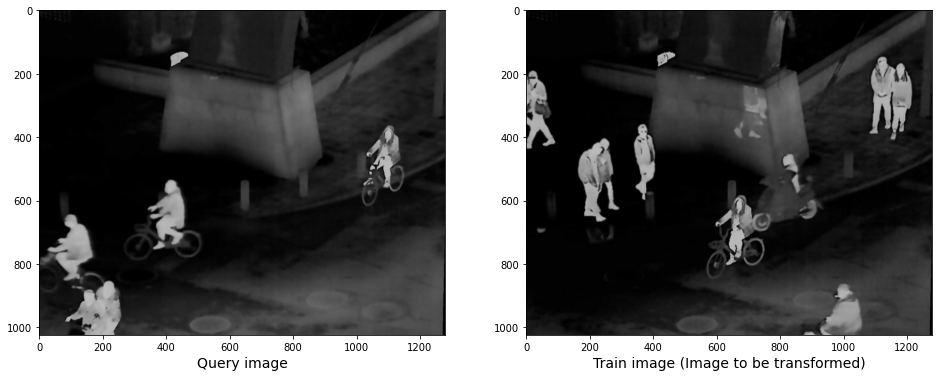

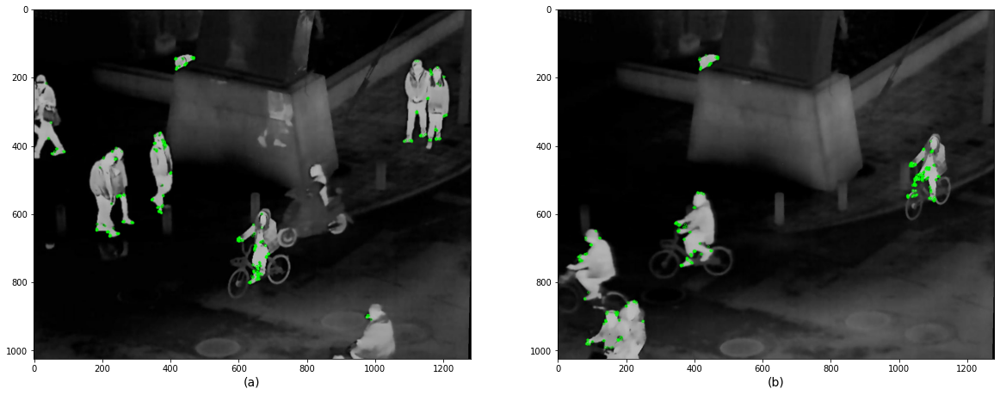

Using: bf feature matcher
Raw matches (Brute force): 132


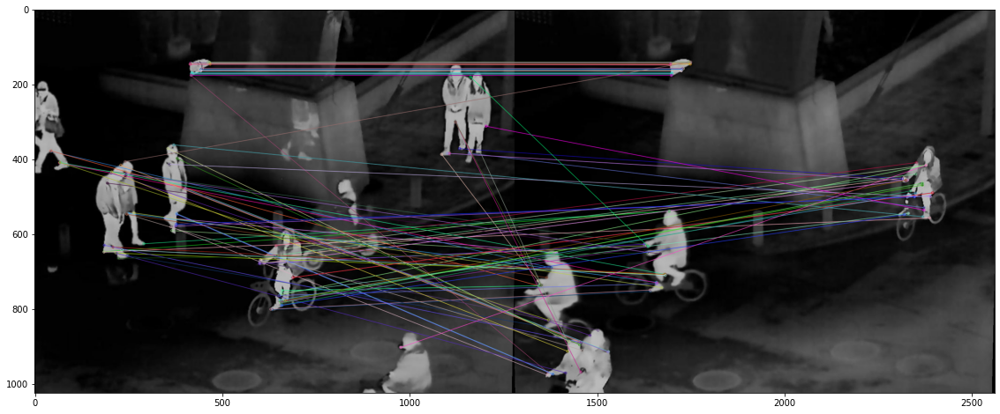

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
cv2.ocl.setUseOpenCL(False)

feature_extractor = 'orb' # one of 'brisk', 'orb'
feature_matching = 'bf'
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed
trainImg = imageio.imread('/content/drive/MyDrive/IR_sample_assignment/LLVIP/010018.jpg')
trainImg_gray = cv2.cvtColor(trainImg, cv2.COLOR_RGB2GRAY)

queryImg = imageio.imread('/content/drive/MyDrive/IR_sample_assignment/LLVIP/010019.jpg')
# Opencv defines the color channel in the order BGR. 
# Transform it to RGB to be compatible to matplotlib
queryImg_gray = cv2.cvtColor(queryImg, cv2.COLOR_RGB2GRAY)

fig, (ax1, ax2) = plt.subplots(nrows=1, ncols=2, constrained_layout=False, figsize=(16,9))
ax1.imshow(queryImg, cmap="gray")
ax1.set_xlabel("Query image", fontsize=14)

ax2.imshow(trainImg, cmap="gray")
ax2.set_xlabel("Train image (Image to be transformed)", fontsize=14)

plt.show()
def detectAndDescribe(image, method=None):
    """
    Compute key points and feature descriptors using an specific method
    """
    
    assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
    
    # detect and extract features from the image
    if method == 'sift':
        descriptor = cv2.xfeatures2d.SIFT_create()
    elif method == 'surf':
        descriptor = cv2.xfeatures2d.SURF_create()
    elif method == 'brisk':
        descriptor = cv2.BRISK_create()
    elif method == 'orb':
        descriptor = cv2.ORB_create()
        
    # get keypoints and descriptors
    (kps, features) = descriptor.detectAndCompute(image, None)
    
    return (kps, features)
kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv2.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv2.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches
    
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv2.drawMatches(trainImg,kpsA,queryImg,kpsB,matches[:100],
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
    img3 = cv2.drawMatches(trainImg,kpsA,queryImg,kpsB,np.random.choice(matches,100),
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    

plt.imshow(img3)
plt.show()

EOH

In [ ]:

class EOH():
    '''
    Python implementation by: Cristiano Nunes <cfgnunes@gmail.com>
    Original MATLAB source code: https://github.com/ngunsu/matlab-eoh-sift
    Described in the paper [1].

    This implementation may produces a different result
    from original MATLAB source code, because:
    - The float precision differ to locate the "z maximums";
    - The implementation of Canny detector is different.

    Extract the EOH (Edge Oriented Histogram).

    Input image should be a single-band image,
    but if it's a multiband (e.g. RGB) image
    only the 1st band will be used.

    The output descriptor is a array with 4x4x5=80 values.

    The image is split into 4x4 non-overlapping rectangular regions.
    For each region, 5 edge orientation histogram is computed,
    (horizontal, vertical, 2 diagonals and 1 non-directional).
    '''

    _N_ROW_REGIONS = 4
    _N_COL_REGIONS = 4

    def __init__(self, window_size=80):
        self.window_size = window_size

        # Initialize the filter bank
        self._initialize_filter_bank()

    def descriptor_size(self):
        return int(self._N_ROW_REGIONS * self._N_COL_REGIONS * self._nfilters)

    @staticmethod
    def descriptor_type():
        return np.float32

    # Return a list of descriptors for each region around all keypoints.
    # The size of the region is defined by "window_size".
    def compute(self, image, keypoints):

        if not keypoints:
            return None

        descriptors = np.zeros(
            (len(keypoints), self.descriptor_size()), self.descriptor_type())

        for i, k in enumerate(keypoints):
            # Crop a region (window_size X window_size)
            # around the keypoint
            window_image = self._crop_region(
                image, (k.pt[1], k.pt[0]), self.window_size)

            if window_image is None:
                continue

            maxp = self._apply_filters(window_image)

            # Compute the descriptor for this region
            descriptors[i] = self._compute_subregions(maxp)

        return keypoints, descriptors

    # Return the descriptor for a image
    def compute_descriptor(self, image):
        maxp = self._apply_filters(image)
        descriptor = self._compute_subregions(maxp)
        return descriptor

    # Apply the filters in the image and return a matrix containing
    # the index values of maximum filters responses.
    # Each value of this returned matrix represent which filter had a
    # maximum response for that pixel coordinate.
    def _apply_filters(self, image):
        if image.size == 0:
            return None

        if image.dtype != np.uint8:
            image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        image_rows, image_cols = image.shape
        image_float = image.copy().astype(np.float32)

        filtered_images = np.zeros((image_rows, image_cols, self._nfilters),
                                   np.float32)

        for i, fil in enumerate(self._filters):
            filtered_images[:, :, i] = np.abs(
                cv2.filter2D(src=image_float, ddepth=-1, kernel=fil))

        # Matrix containing the index values of maximum filters responses.
        maxp = filtered_images.argmax(2)
        maxp += 1

        # Apply an Canny edge detector
        image_canny = self._apply_canny(image)
        maxp = maxp * (image_canny > 0)

        return maxp

    # Compute the histogram for each subregion and return the descriptor.
    # Every pixel of each subregion contributes to a bin on
    # the histogram according to the filters.
    def _compute_subregions(self, maxp):
        descriptor = np.zeros(self.descriptor_size(), self.descriptor_type())
        image_rows, image_cols = maxp.shape

        step = 0
        for i in range(self._N_ROW_REGIONS):
            for j in range(self._N_COL_REGIONS):
                i_1 = i * round(image_rows / self._N_ROW_REGIONS)
                j_1 = j * round(image_cols / self._N_COL_REGIONS)
                i_2 = (i + 1) * round(image_rows / self._N_ROW_REGIONS)
                j_2 = (j + 1) * round(image_cols / self._N_COL_REGIONS)

                # Crop the subregion
                subregion = maxp[i_1:i_2, j_1:j_2]

                # Compute the histogram
                histogram = cv2.calcHist(
                    images=[subregion.astype(np.uint8)], channels=None,
                    mask=None, histSize=[self._nfilters],
                    ranges=[1, self._nfilters + 1])
                descriptor[step:(step + self._nfilters)] = histogram.T
                step += self._nfilters

        # Normalize the final descriptor
        cv2.normalize(descriptor, descriptor)
        return descriptor

    # Crop a region of (size X size) centered around a center reference
    @staticmethod
    def _crop_region(image, center, size):
        image_rows, image_cols = image.shape
        i, j = center
        half_size = size / 2

        # Check the boundaries
        i_1 = np.max((0, i - half_size))
        i_1 = np.min((image_rows, i_1 + 1))
        i_2 = np.min((image_rows, i + half_size + 1))

        j_1 = np.max((0, j - half_size))
        j_1 = np.min((image_cols, j_1 + 1))
        j_2 = np.min((image_cols, j + half_size + 1))

        if i_1 == i_2 or j_1 == j_2:
            return None

        return image[int(i_1):int(i_2), int(j_1):int(j_2)]

    @staticmethod
    def _apply_canny(image):
        # Apply an Gaussian filter to eliminate noise
        sig = 3
        image_filtered = cv2.GaussianBlur(
            src=image, ksize=(sig * 3, sig * 3), sigmaX=sig, sigmaY=sig)

        # Find automatic good threshold values for Canny edge detector
        otsu, _ = cv2.threshold(
            src=image_filtered, thresh=0, maxval=255, type=cv2.THRESH_OTSU)

        threshold = otsu * 0.5
        image_edge = cv2.Canny(image_filtered, 0.5 * threshold, threshold)

        return image_edge

    def _initialize_filter_bank(self):
        # Build a filter bank with Sobel filters
        fil1 = [[1, 2, 1], [0, 0, 0], [-1, -2, -1]]  # Horizontal filter
        fil2 = [[-1, 0, 1], [-2, 0, 2], [-1, 0, 1]]  # Vertical filter
        fil3 = [[2, 2, -1], [2, -1, -1], [-1, -1, -1]]  # 45 filter
        fil4 = [[-1, 2, 2], [-1, -1, 2], [-1, -1, -1]]  # 135 filter
        fil5 = [[-1, 0, 1], [0, 0, 0], [1, 0, -1]]  # No orientation filter

        self._filters = []
        self._filters.append(np.array(fil1))
        self._filters.append(np.array(fil2))
        self._filters.append(np.array(fil3))
        self._filters.append(np.array(fil4))
        self._filters.append(np.array(fil5))

        self._nfilters = len(self._filters)

SIFT

In [ ]:
# to run in google colab
import sys
if 'google.colab' in sys.modules:
    import subprocess
    subprocess.call("pip install -U opencv-python".split())

from random import randrange
import matplotlib.pyplot as plt
import numpy as np
import cv2
figsize = (10, 10)
rgb_l = cv2.cvtColor(cv2.imread("/content/drive/MyDrive/IR_sample_assignment/LLVIP/010018.jpg"), cv2.COLOR_BGR2RGB)
gray_l = cv2.cvtColor(rgb_l, cv2.COLOR_RGB2GRAY)
rgb_r = cv2.cvtColor(cv2.imread("/content/drive/MyDrive/IR_sample_assignment/LLVIP/010019.jpg"), cv2.COLOR_BGR2RGB)
gray_r = cv2.cvtColor(rgb_r, cv2.COLOR_RGB2GRAY)
# use orb if sift is not installed
feature_extractor = cv2.SIFT_create()

# find the keypoints and descriptors with chosen feature_extractor
kp_l, desc_l = feature_extractor.detectAndCompute(gray_l, None)
kp_r, desc_r = feature_extractor.detectAndCompute(gray_r, None)

test = cv2.drawKeypoints(rgb_l, kp_l, None, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)

plt.figure(figsize=figsize)
plt.imshow(test)
plt.title("keypoints")
plt.show()

bf = cv2.BFMatcher()
matches = bf.knnMatch(desc_l, desc_r, k=2)

# Apply ratio test
good_and_second_good_match_list = []
for m in matches:
    if m[0].distance/m[1].distance < 0.5:
        good_and_second_good_match_list.append(m)
good_match_arr = np.asarray(good_and_second_good_match_list)[:,0]

# show only 30 matches
im_matches = cv2.drawMatchesKnn(rgb_l, kp_l, rgb_r, kp_r,
                                good_and_second_good_match_list[0:30], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)

plt.figure(figsize=(20, 20))
plt.imshow(im_matches)
plt.title("keypoints matches")
plt.show()


AttributeError: ignored

KAZE

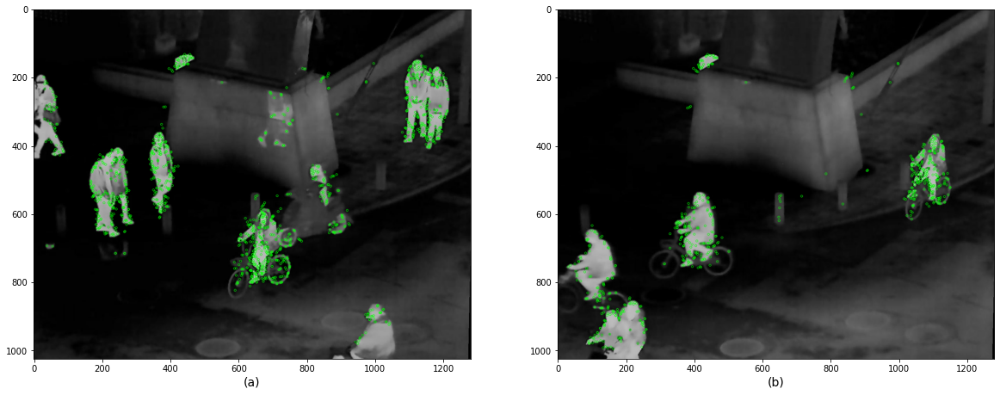

Using: bf feature matcher
Raw matches (Brute force): 248


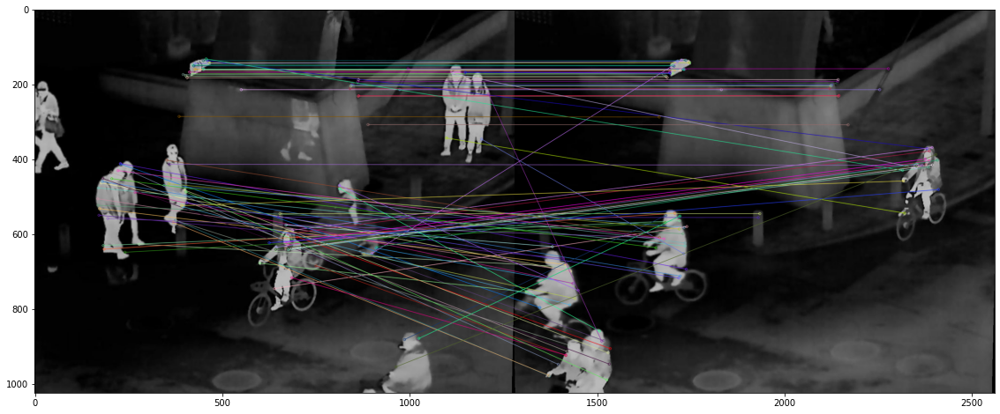

In [ ]:
from google.colab.patches import cv2_imshow
import cv2
import numpy as np
import matplotlib.pyplot as plt
feature_matching = 'bf'
feature_extractor = 'kaze'
rgb_l = cv2.cvtColor(cv2.imread("/content/drive/MyDrive/IR_sample_assignment/LLVIP/010018.jpg"), cv2.COLOR_BGR2RGB)
gray_l = cv2.cvtColor(rgb_l, cv2.COLOR_RGB2GRAY)
rgb_r = cv2.cvtColor(cv2.imread("/content/drive/MyDrive/IR_sample_assignment/LLVIP/010019.jpg"), cv2.COLOR_BGR2RGB)
gray_r = cv2.cvtColor(rgb_r, cv2.COLOR_RGB2GRAY)
AKAZE = cv2.AKAZE_create()
kpsA, featuresA = AKAZE.detectAndCompute(gray_l, None)
kpsB, featuresB= AKAZE.detectAndCompute(gray_r, None)

# display the keypoints and features detected on both images
fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
ax1.imshow(cv2.drawKeypoints(rgb_l,kpsA,None,color=(0,255,0)))
ax1.set_xlabel("(a)", fontsize=14)
ax2.imshow(cv2.drawKeypoints(rgb_r,kpsB,None,color=(0,255,0)))
ax2.set_xlabel("(b)", fontsize=14)

plt.show()

def createMatcher(method,crossCheck):
    "Create and return a Matcher Object"
    
    if method == 'sift' or method == 'surf':
        bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
    elif method == 'orb' or method == 'brisk' or method == 'kaze':
        bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
    return bf

def matchKeyPointsBF(featuresA, featuresB, method):
    bf = createMatcher(method, crossCheck=True)
        
    # Match descriptors.
    best_matches = bf.match(featuresA,featuresB)
    
    # Sort the features in order of distance.
    # The points with small distance (more similarity) are ordered first in the vector
    rawMatches = sorted(best_matches, key = lambda x:x.distance)
    print("Raw matches (Brute force):", len(rawMatches))
    return rawMatches

def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
    bf = createMatcher(method, crossCheck=False)
    # compute the raw matches and initialize the list of actual matches
    rawMatches = bf.knnMatch(featuresA, featuresB, 2)
    print("Raw matches (knn):", len(rawMatches))
    matches = []

    # loop over the raw matches
    for m,n in rawMatches:
        # ensure the distance is within a certain ratio of each
        # other (i.e. Lowe's ratio test)
        if m.distance < n.distance * ratio:
            matches.append(m)
    return matches
    
print("Using: {} feature matcher".format(feature_matching))

fig = plt.figure(figsize=(20,8))

if feature_matching == 'bf':
    matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
    img3 = cv2.drawMatches(gray_l,kpsA,gray_r,kpsB,matches[:100],
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
elif feature_matching == 'knn':
    matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
    img3 = cv2.drawMatches(gray_l,kpsA,gray_r,kpsB,np.random.choice(matches,100),
                           None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    

plt.imshow(img3)
plt.show()

# Calibration

In [ ]:
def getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh):
    # convert the keypoints to numpy arrays
    kpsA = np.float32([kp.pt for kp in kpsA])
    kpsB = np.float32([kp.pt for kp in kpsB])
    
    if len(matches) > 4:

        # construct the two sets of points
        ptsA = np.float32([kpsA[m.queryIdx] for m in matches])
        ptsB = np.float32([kpsB[m.trainIdx] for m in matches])
        
        # estimate the homography between the sets of points
        (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
            reprojThresh)

        return (matches, H, status)
    else:
        return None

M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
if M is None:
    print("Error!")
(matches, H, status) = M
print(H)

[[-2.88998962e+00 -4.13063064e-01  8.79239204e+02]
 [-5.94266871e-01 -1.07644343e+00  2.68323404e+02]
 [-4.22344705e-03 -1.12430423e-03  1.00000000e+00]]


# Blending

Perspective Blending

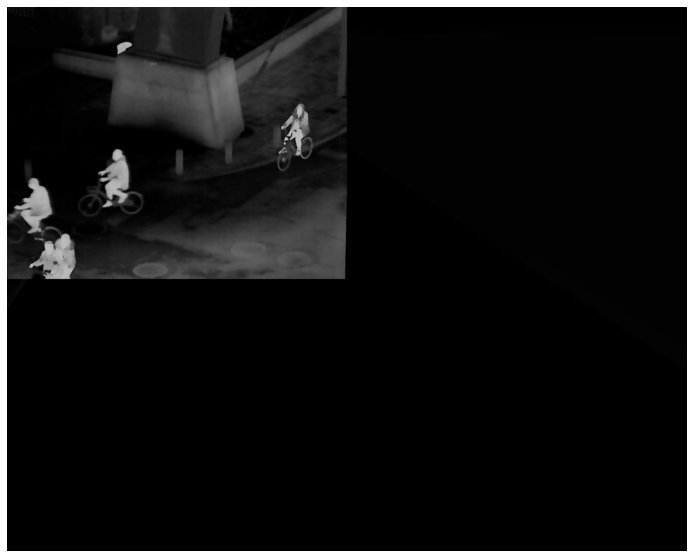

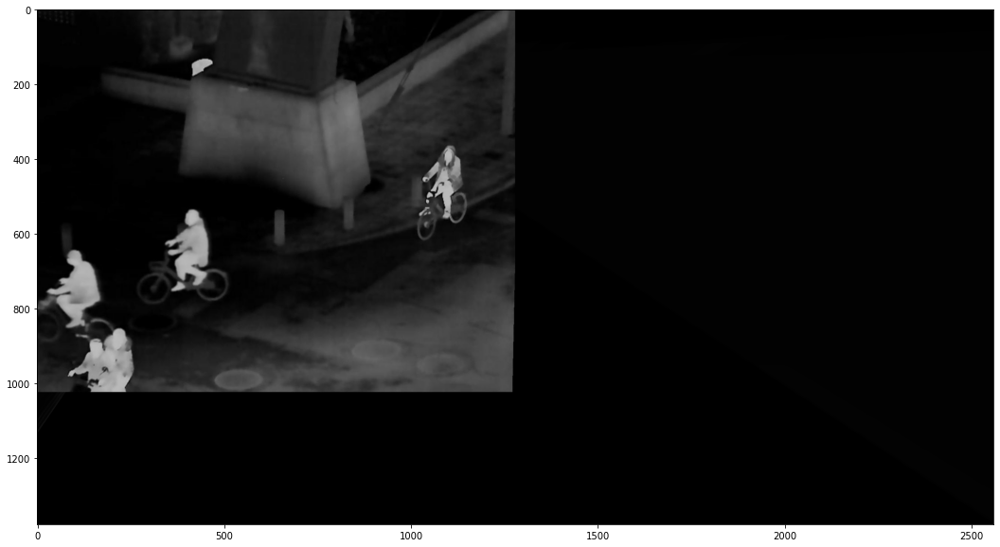

In [ ]:
# Apply panorama correction
width = trainImg_gray.shape[1] + queryImg_gray.shape[1]
height = trainImg_gray.shape[0] + queryImg_gray.shape[0]

result = cv2.warpPerspective(trainImg_gray, H, (width, height))
result[0:queryImg_gray.shape[0], 0:queryImg_gray.shape[1]] = queryImg

plt.figure(figsize=(20,10))
plt.imshow(result)

plt.axis('off')
plt.show()

# transform the panorama image to grayscale and threshold it 
gray = cv2.cvtColor(result, cv2.COLOR_BGR2GRAY)
thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]

# Finds contours from the binary image
cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
cnts = imutils.grab_contours(cnts)

# get the maximum contour area
c = max(cnts, key=cv2.contourArea)

# get a bbox from the contour area
(x, y, w, h) = cv2.boundingRect(c)

# crop the image to the bbox coordinates
result = result[y:y + h, x:x + w]

# show the cropped image
plt.figure(figsize=(20,10))
plt.imshow(result)

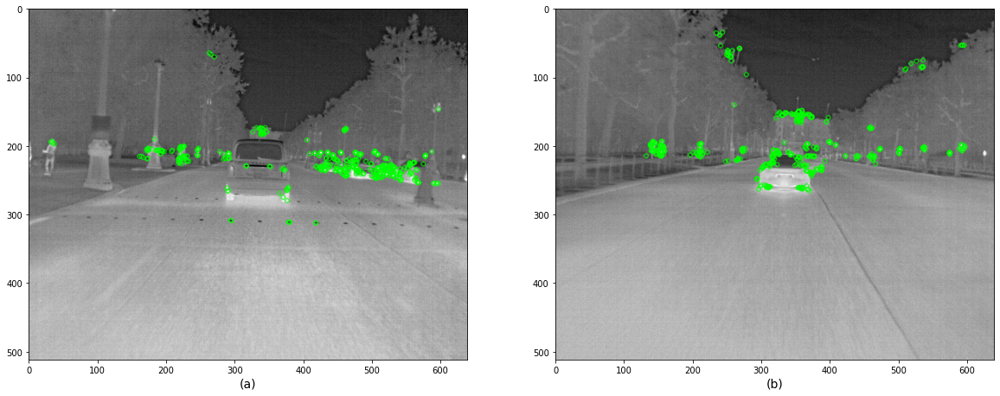

Using: bf feature matcher
Raw matches (Brute force): 138
[[-6.55398370e-01  8.03628479e-01  2.83938915e+02]
 [-1.08061332e+00  1.42916354e+00  2.91894185e+02]
 [-3.07111398e-03  4.16979550e-03  1.00000000e+00]]


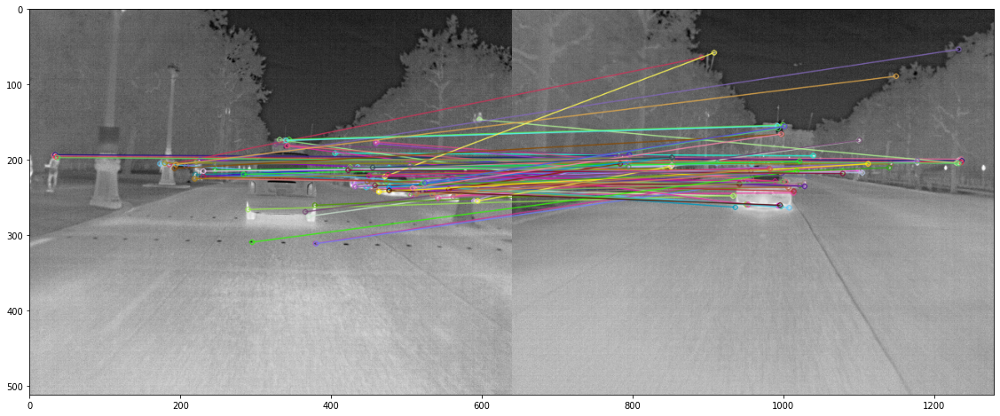

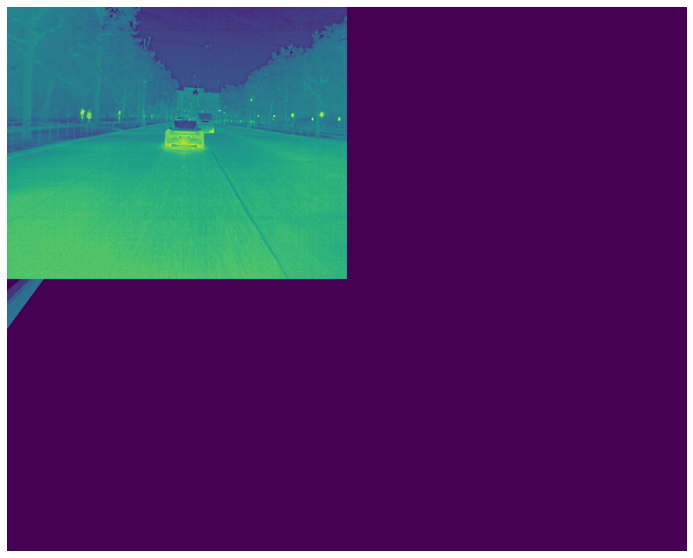

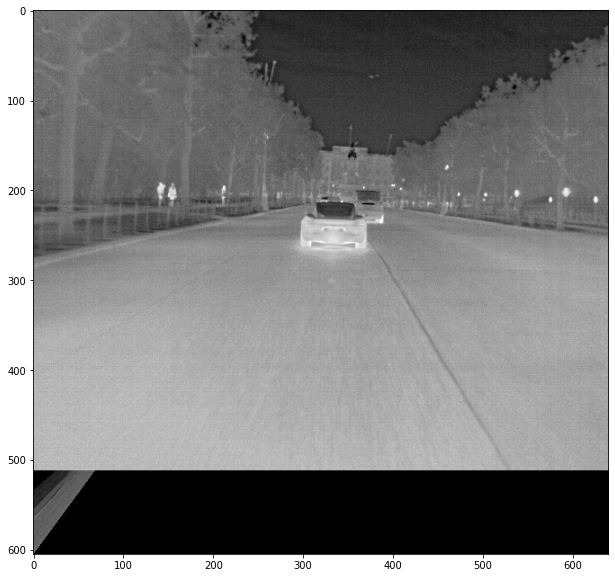

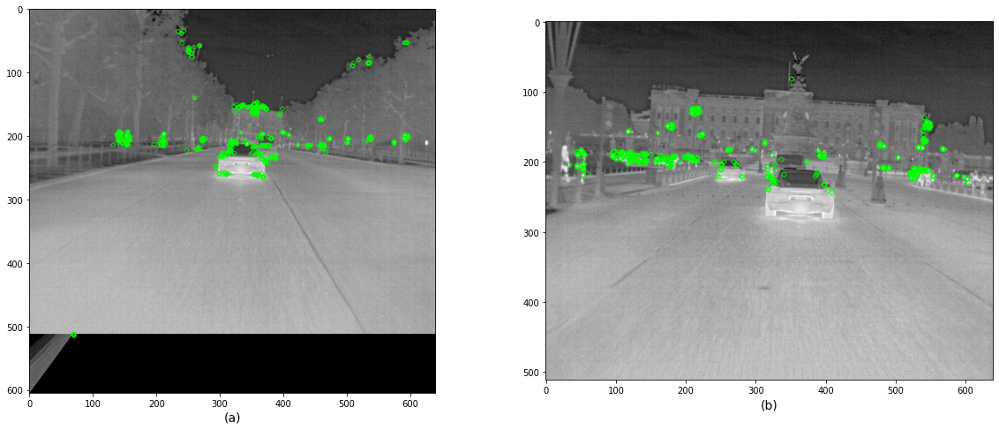

Using: bf feature matcher
Raw matches (Brute force): 132
[[-7.77628553e-02 -3.97608906e-01  1.22635215e+02]
 [-1.21308799e-01 -6.20343875e-01  1.91221272e+02]
 [-6.32876779e-04 -3.24632367e-03  1.00000000e+00]]


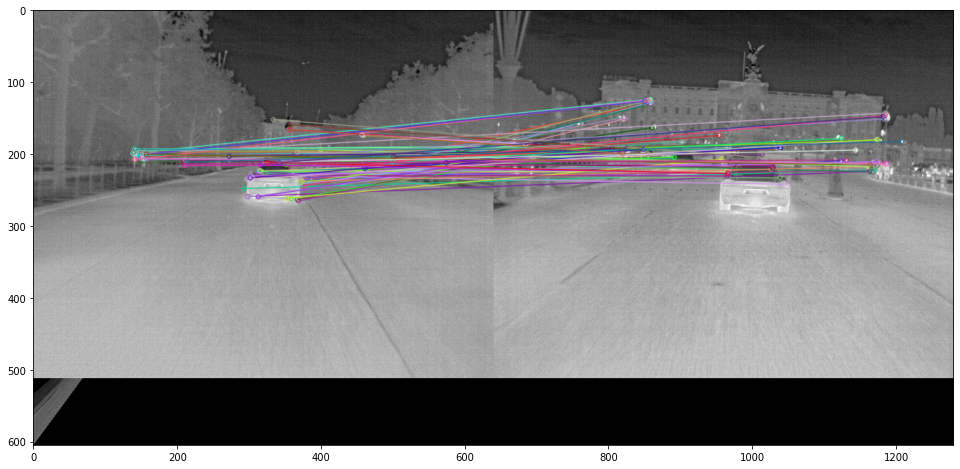

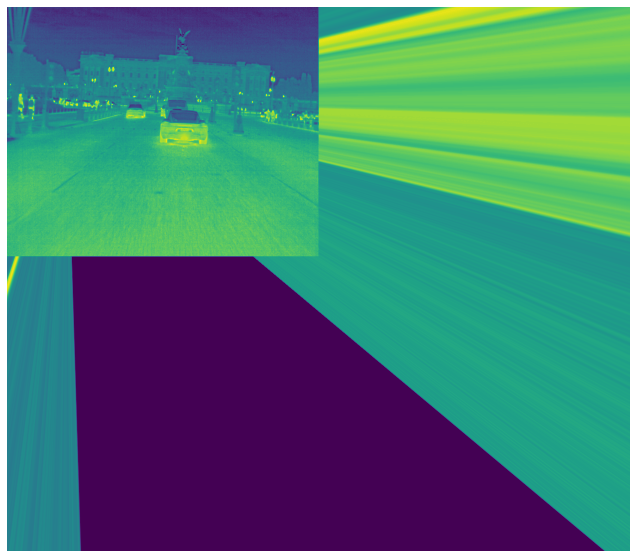

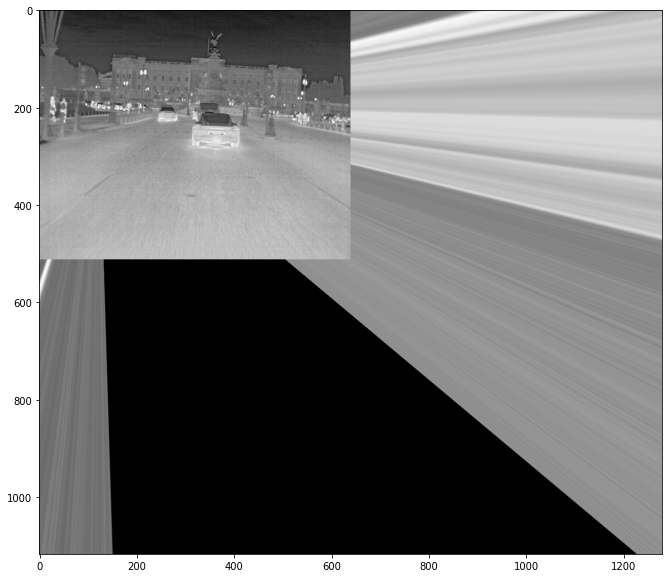

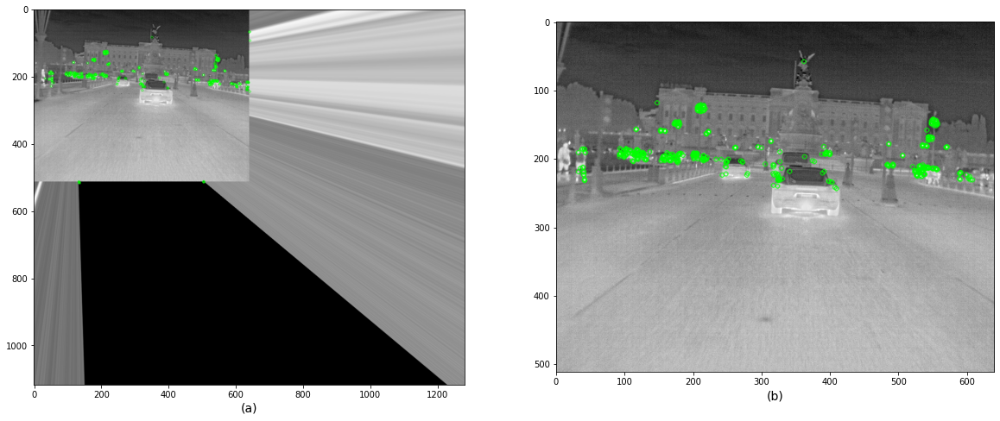

Using: bf feature matcher
Raw matches (Brute force): 256
[[ 1.02288275e+00  4.15178163e-03 -6.83605642e+00]
 [ 6.10614508e-04  1.03210098e+00 -4.86994629e+00]
 [ 1.24524385e-06  2.78220034e-05  1.00000000e+00]]


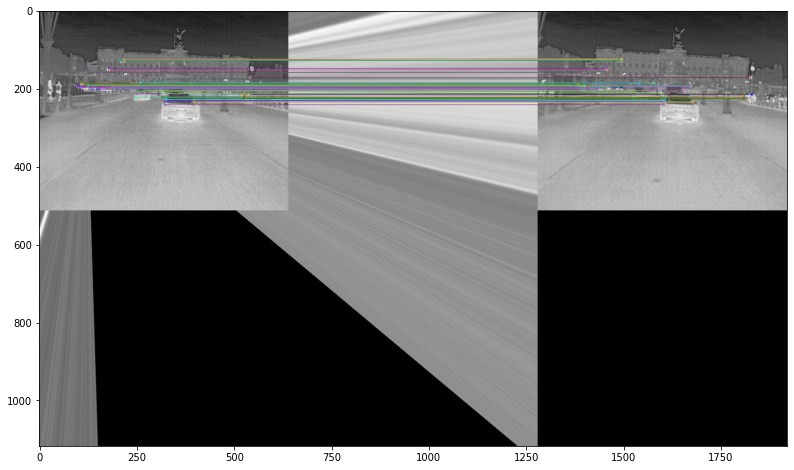

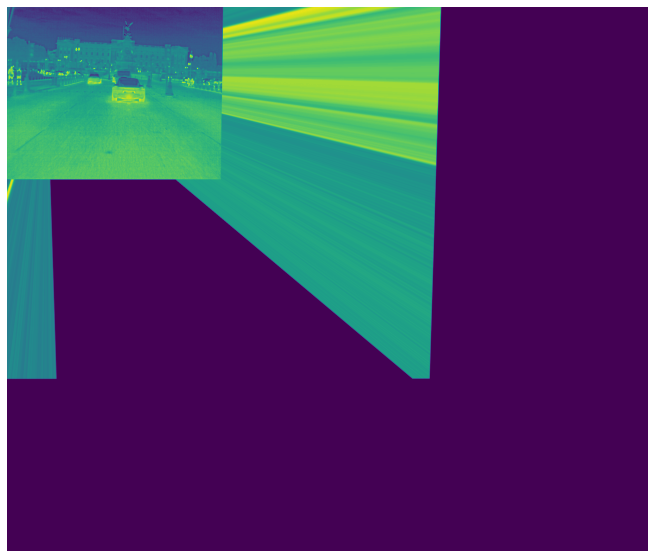

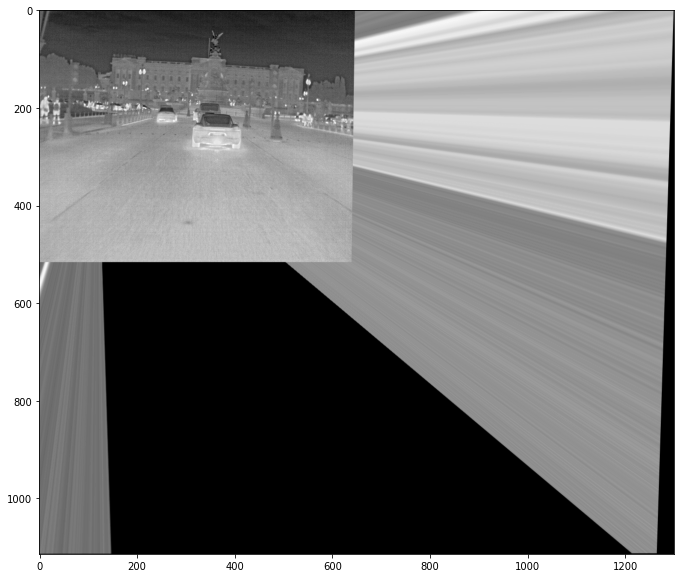

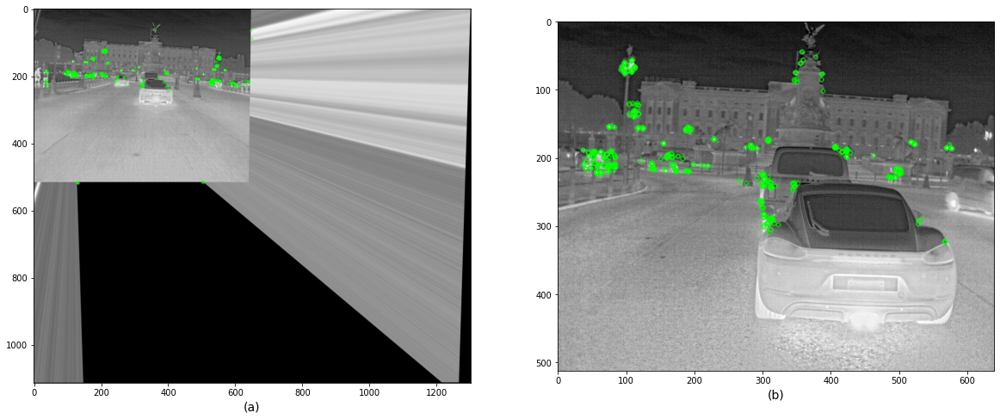

Using: bf feature matcher
Raw matches (Brute force): 140
[[ 1.86508472e+00  1.43435986e+00 -4.60831654e+02]
 [ 1.90251634e+00  1.03814058e+00 -4.51906237e+02]
 [ 7.14357456e-03 -9.16563204e-03  1.00000000e+00]]


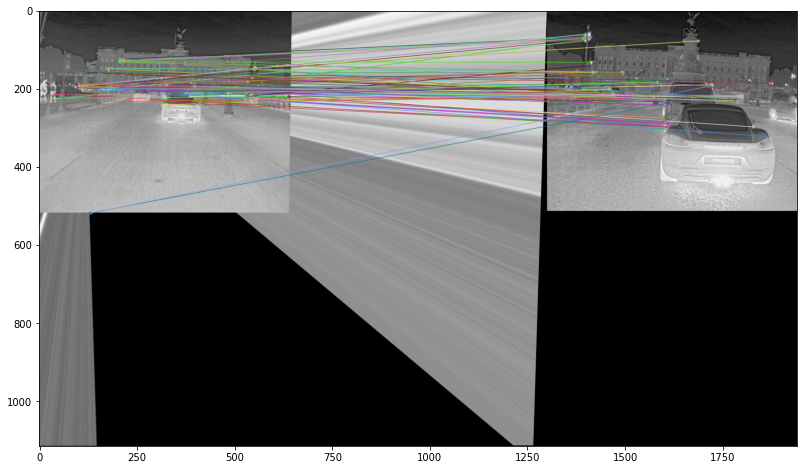

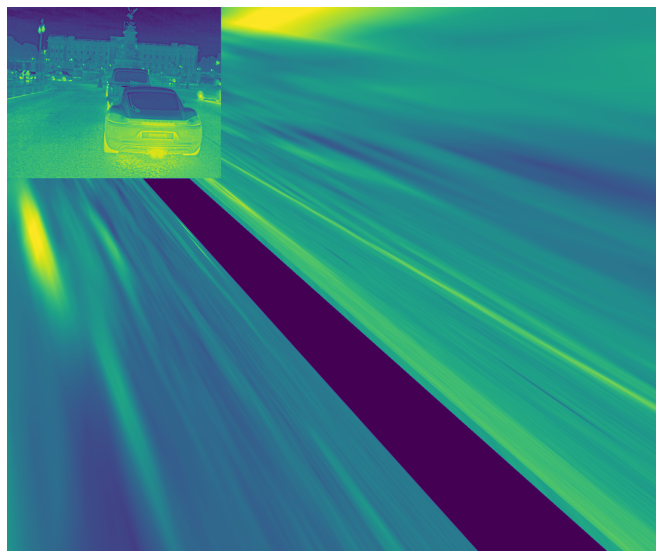

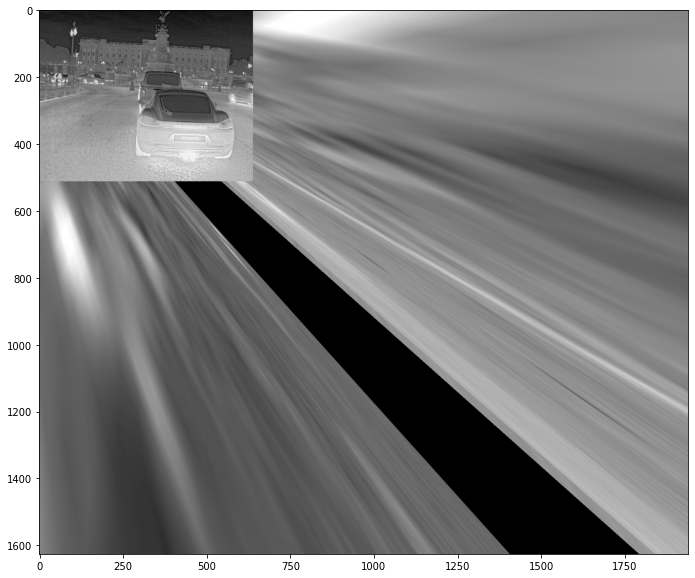

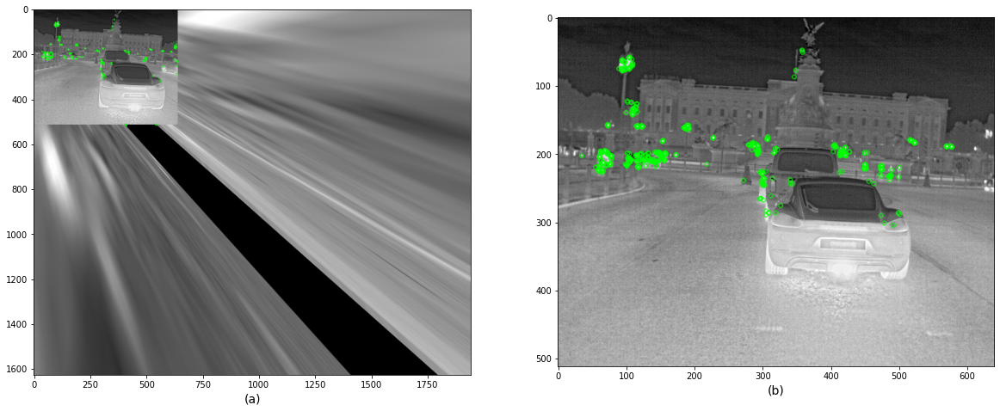

Using: bf feature matcher
Raw matches (Brute force): 189
[[ 1.02446783e+00  3.68532680e-02 -7.74327519e+00]
 [-9.93006585e-04  1.04766779e+00 -1.28372794e-01]
 [-6.61882738e-06  1.46563530e-04  1.00000000e+00]]


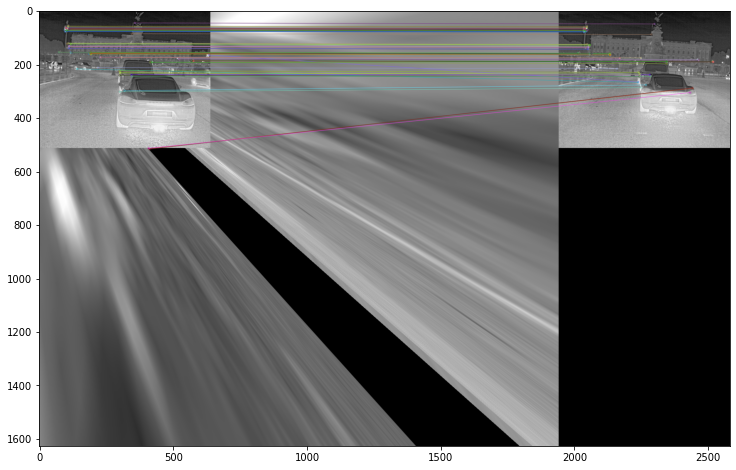

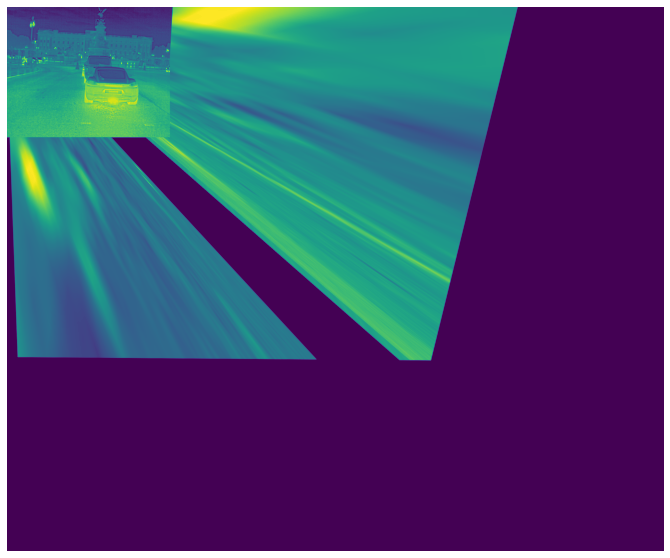

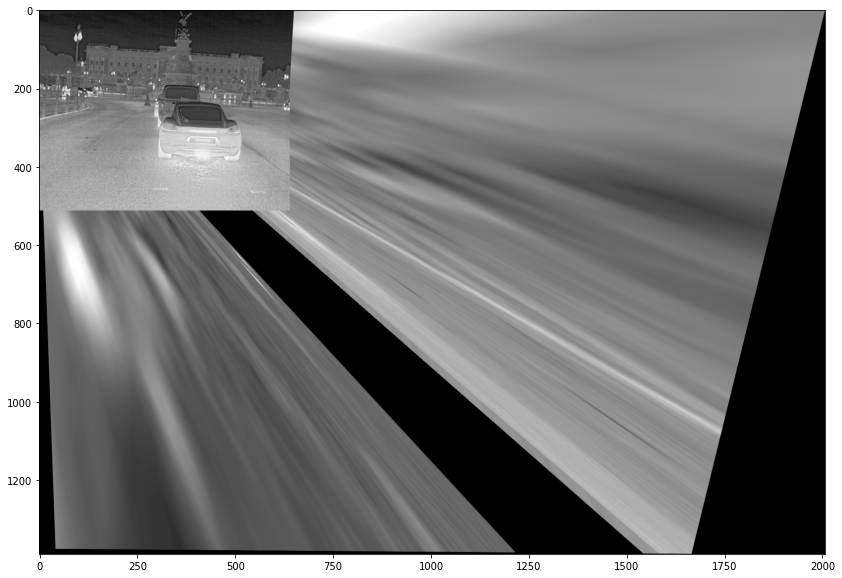

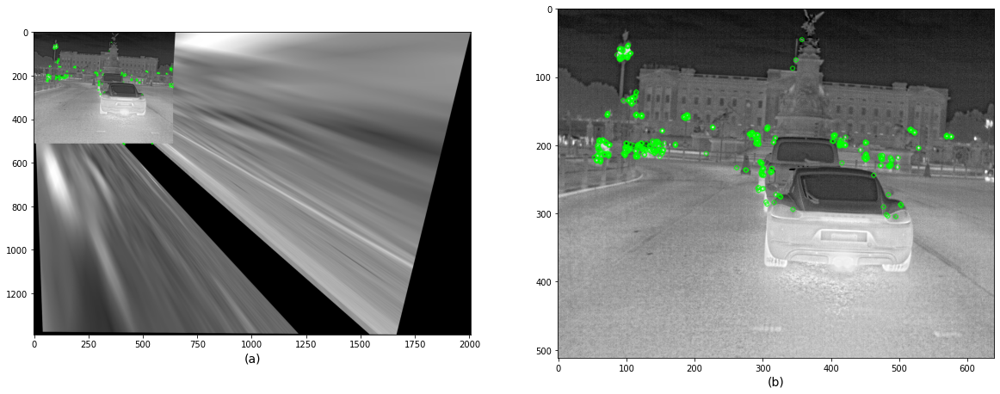

Using: bf feature matcher
Raw matches (Brute force): 300
[[ 9.89297847e-01 -3.13804975e-02  2.97109550e+00]
 [ 4.00297952e-03  9.70435797e-01 -1.76839761e+00]
 [ 8.65970778e-06 -1.09612333e-04  1.00000000e+00]]


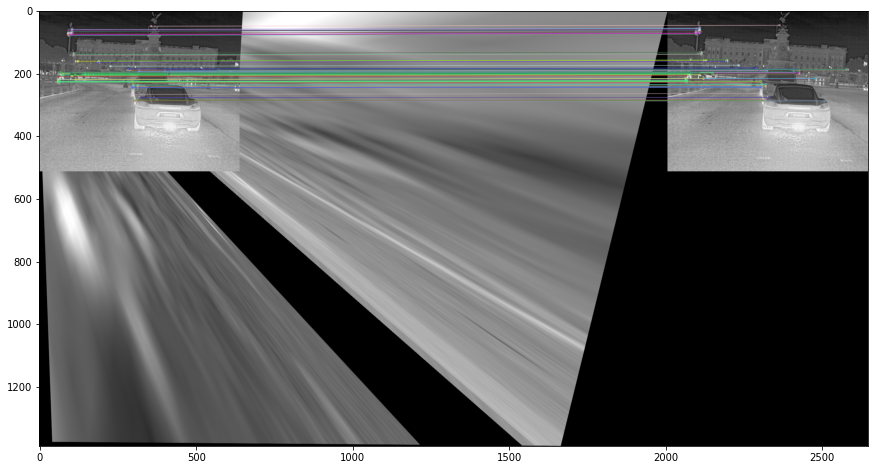

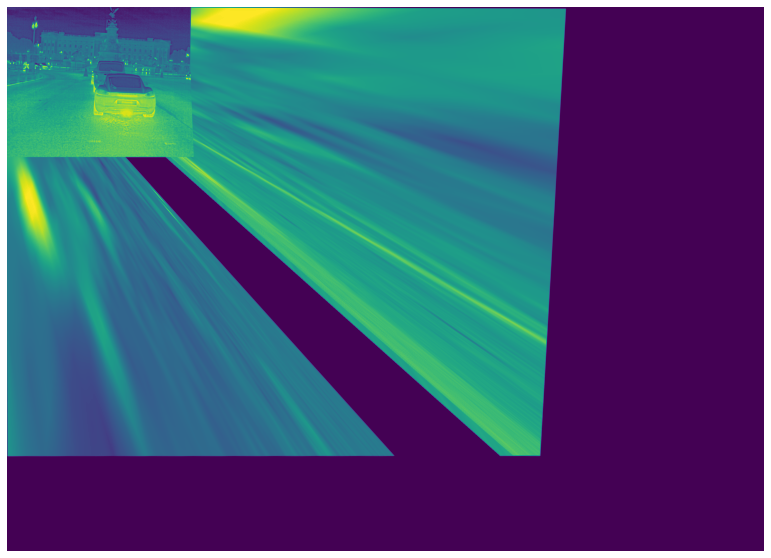

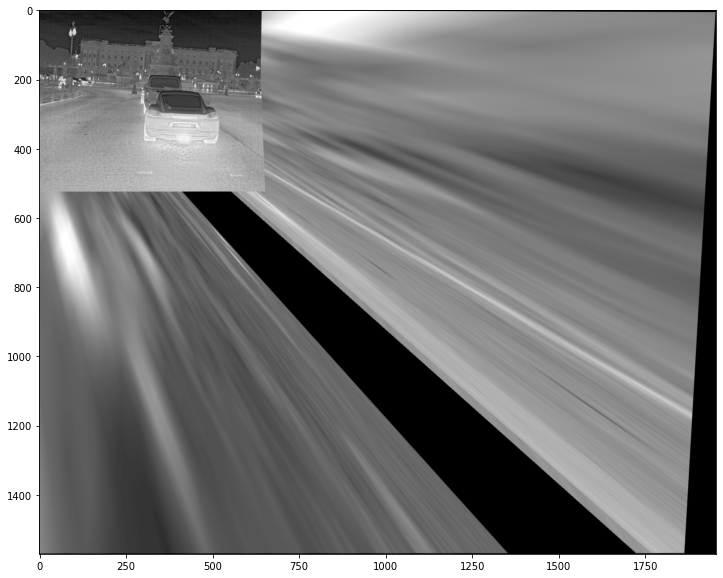

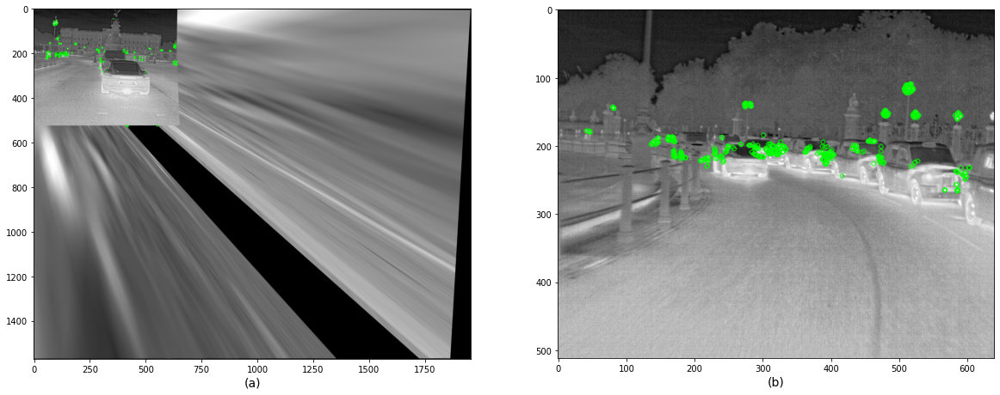

Using: bf feature matcher
Raw matches (Brute force): 138
[[ 2.11863075e+00 -3.63274405e+00  5.15690107e+02]
 [ 4.79499427e-01 -7.96893958e-01  1.09096764e+02]
 [ 4.17564326e-03 -7.09519011e-03  1.00000000e+00]]


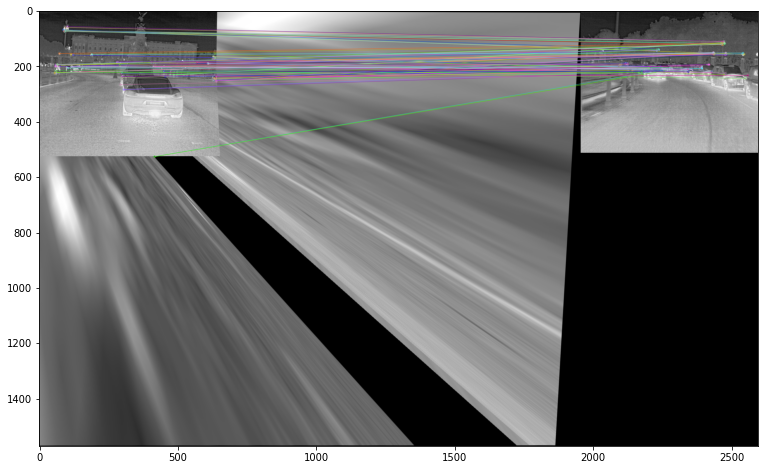

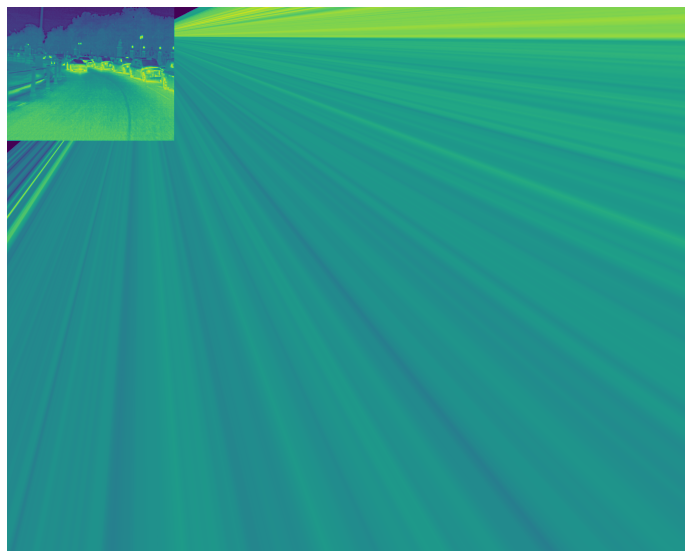

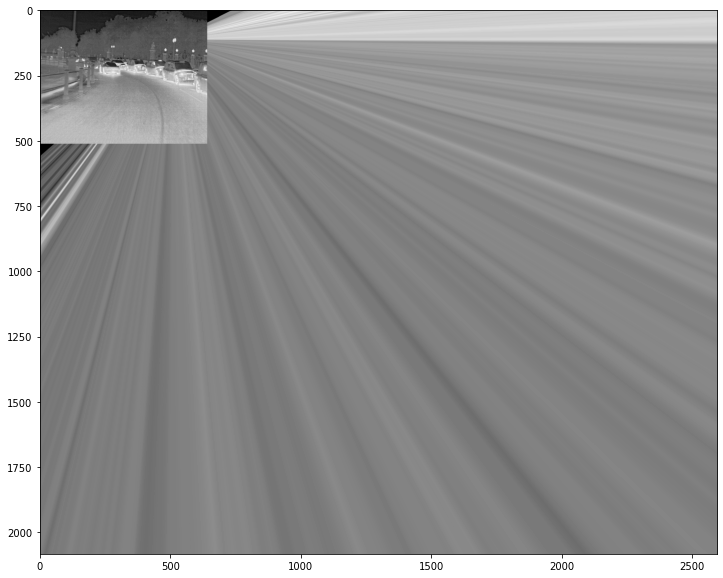

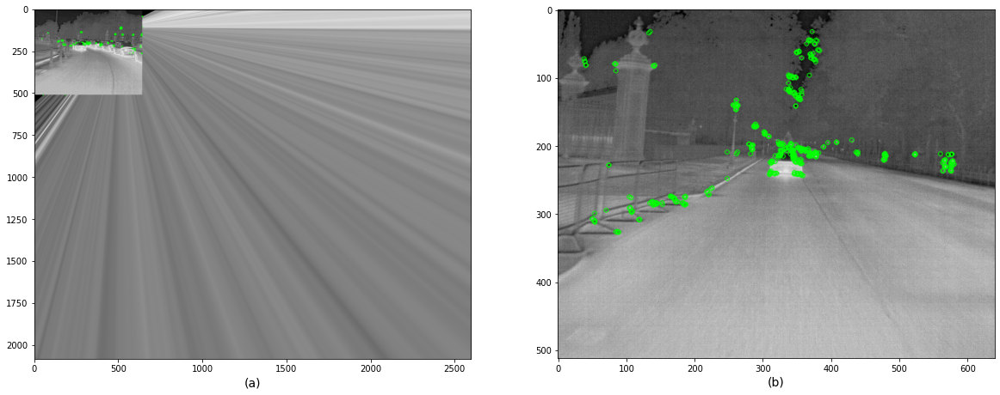

Using: bf feature matcher
Raw matches (Brute force): 129
[[-2.89176790e-01 -9.12763327e-01  3.10352036e+02]
 [-2.24260252e-01 -7.05843703e-01  2.40281539e+02]
 [-9.31888255e-04 -2.94057843e-03  1.00000000e+00]]


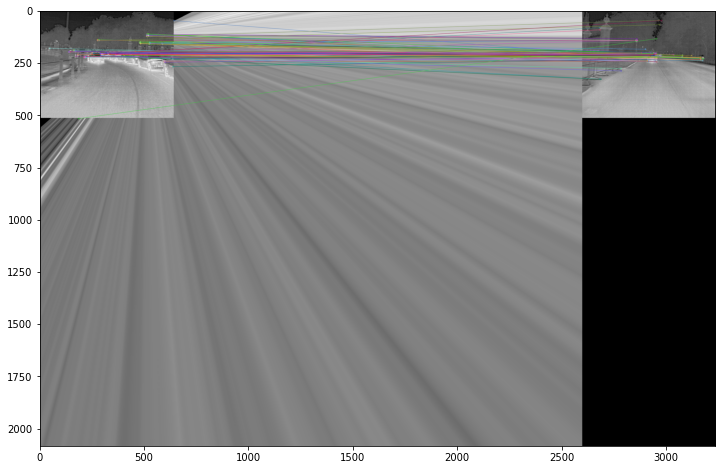

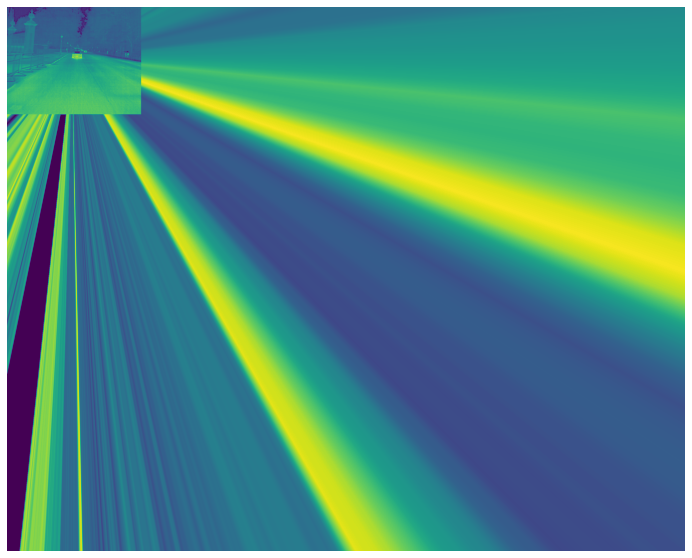

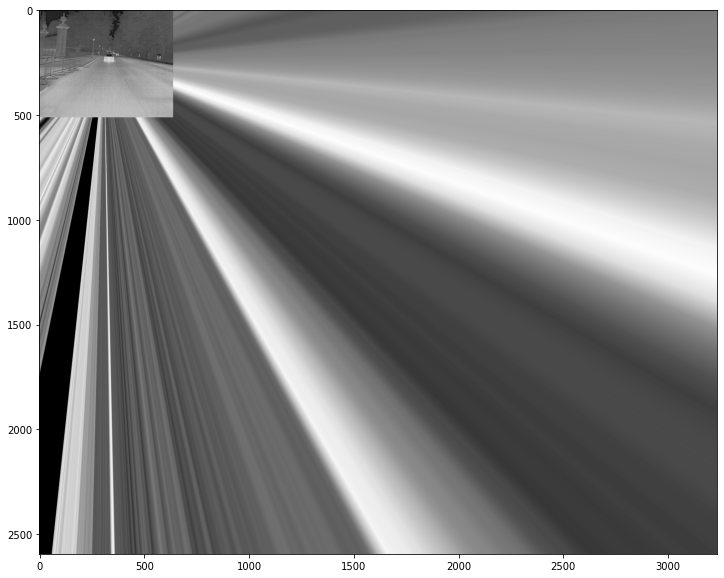

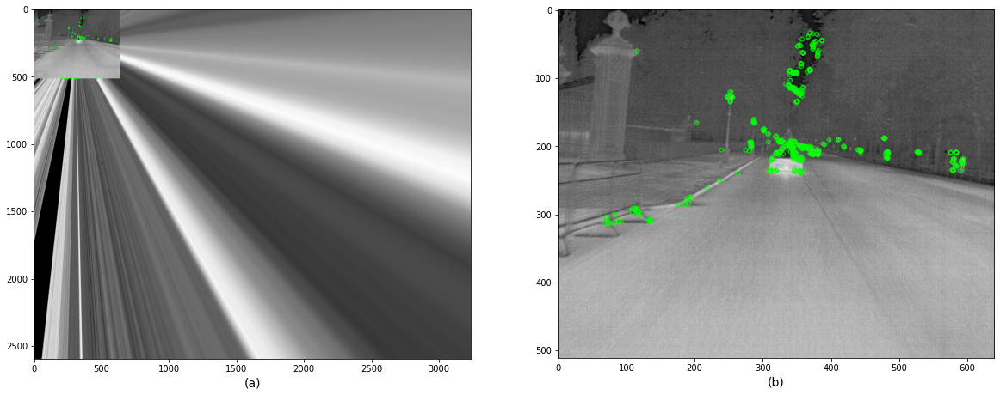

Using: bf feature matcher
Raw matches (Brute force): 229
[[ 3.11936609e+00  1.08236103e-01 -3.69259896e+02]
 [ 6.07358290e-01  2.19669975e+00 -2.35674718e+02]
 [ 3.01011863e-03  3.34321657e-04  1.00000000e+00]]


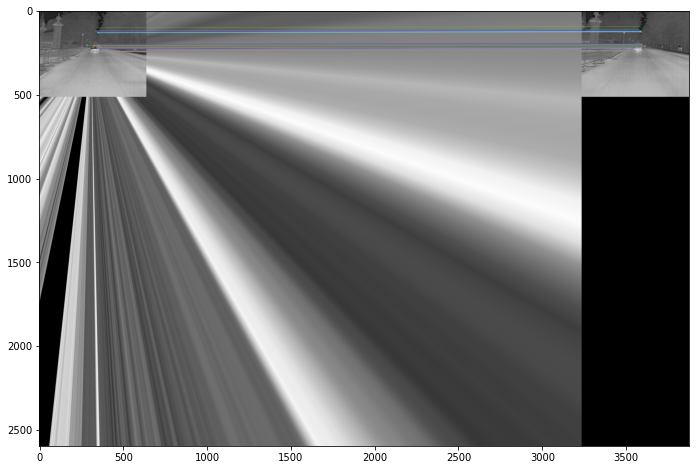

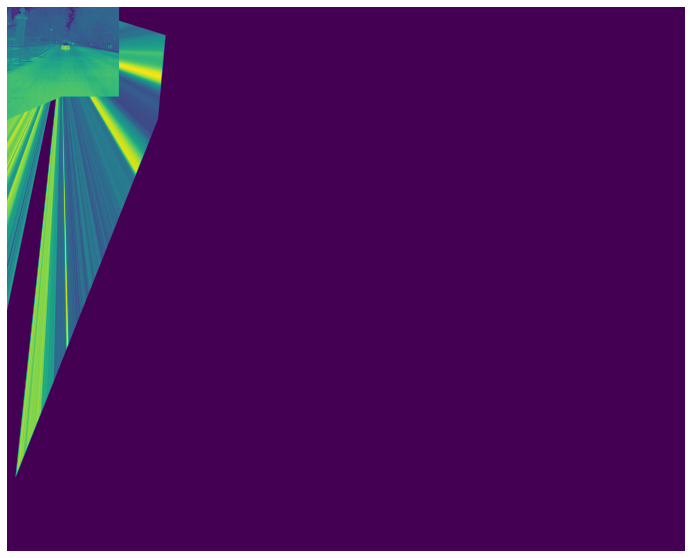

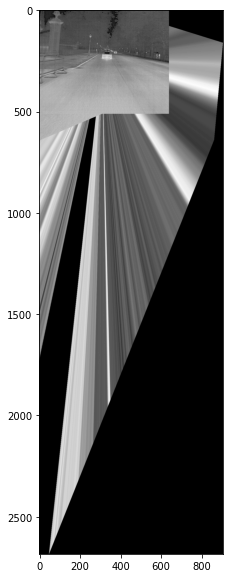

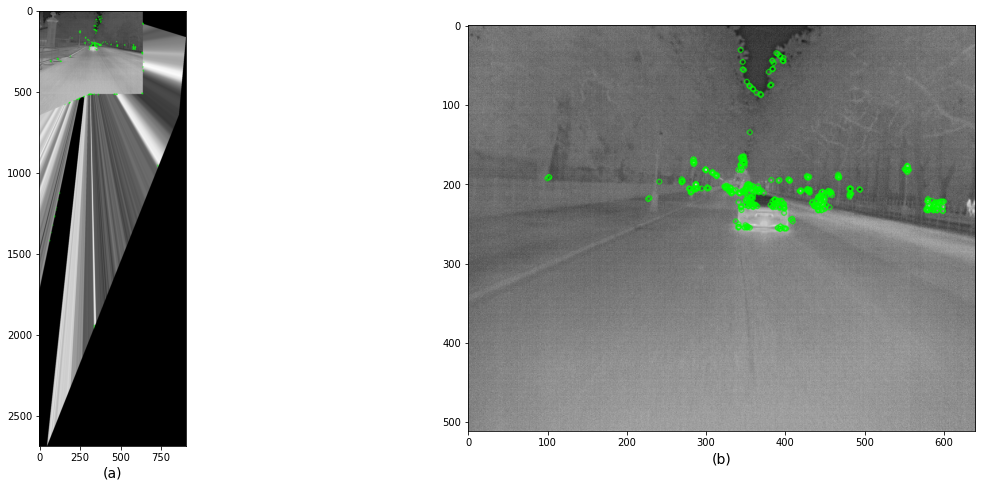

Using: bf feature matcher
Raw matches (Brute force): 127
[[-3.63154463e+00  4.47370007e+01 -2.29495481e+03]
 [-8.04090728e+00  2.57929591e+01  8.23321705e+02]
 [-2.67307891e-02  1.11964937e-01  1.00000000e+00]]


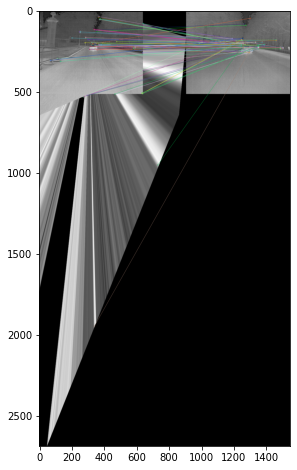

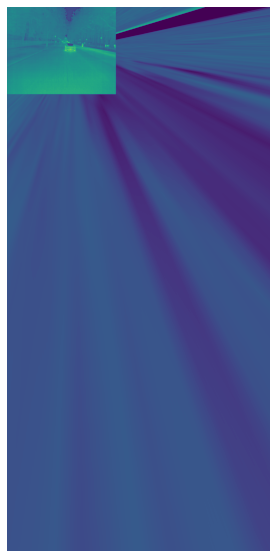

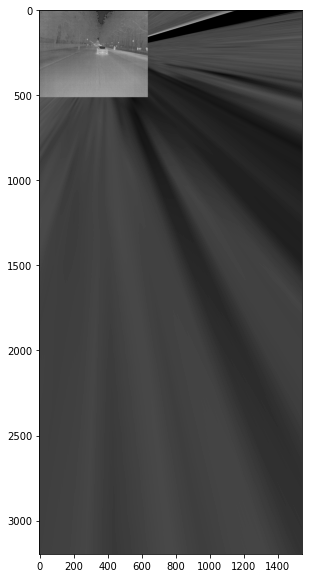

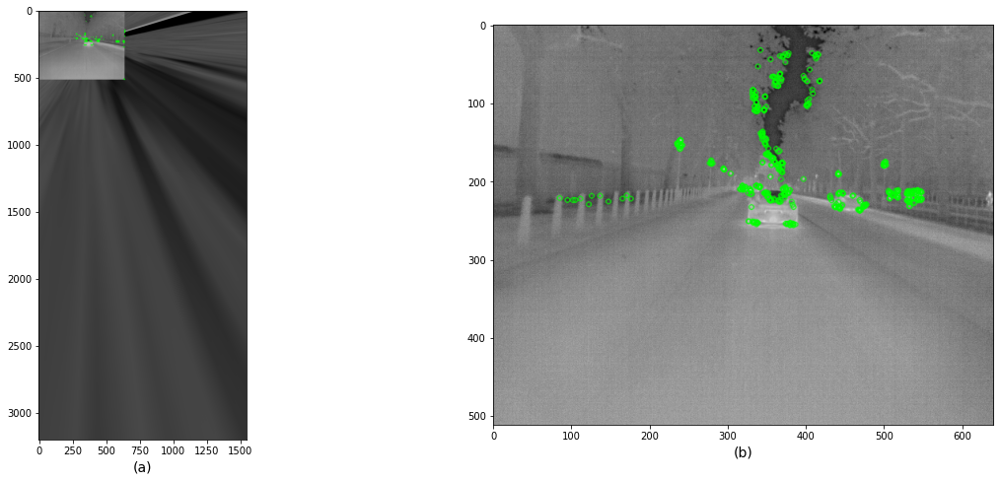

Using: bf feature matcher
Raw matches (Brute force): 134
[[ 7.63436451e-01 -7.94451429e-01  1.43477567e+02]
 [ 5.88335181e-02  2.52858462e-01  7.43052628e+01]
 [ 3.79880577e-04 -2.00287103e-03  1.00000000e+00]]


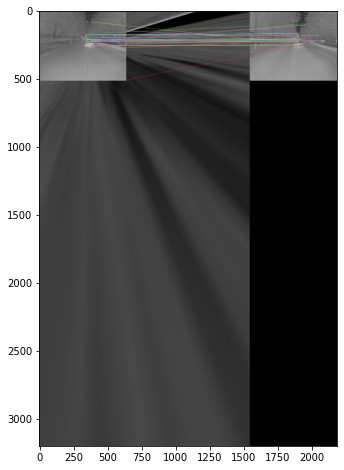

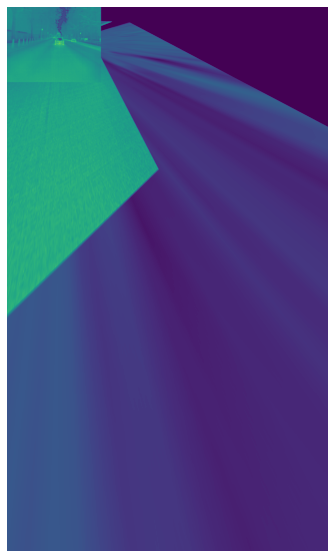

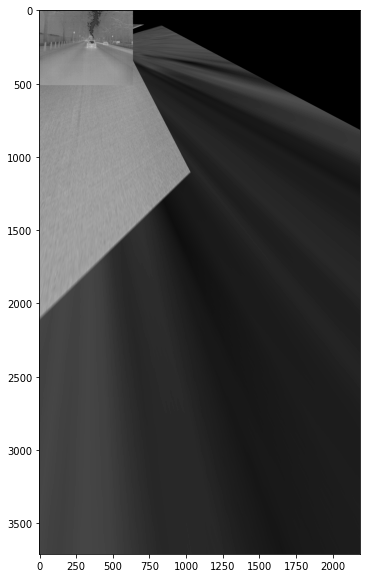

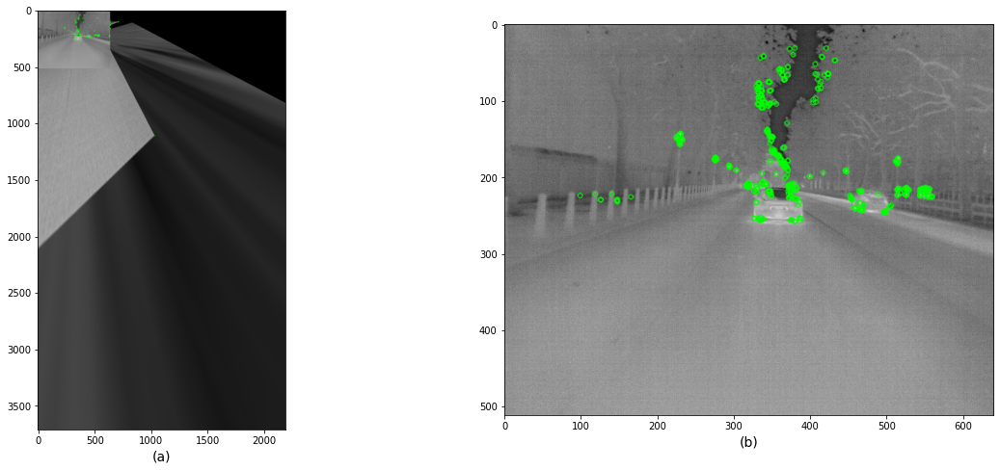

Using: bf feature matcher
Raw matches (Brute force): 232
[[ 1.21053387e+00  1.52716590e-01 -6.15498962e+01]
 [ 3.06053717e-02  1.22148196e+00 -2.88956878e+01]
 [ 8.28431094e-05  4.54059166e-04  1.00000000e+00]]


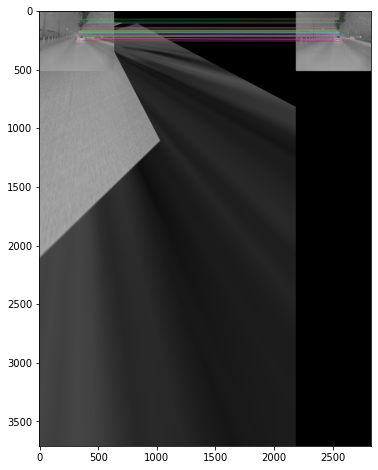

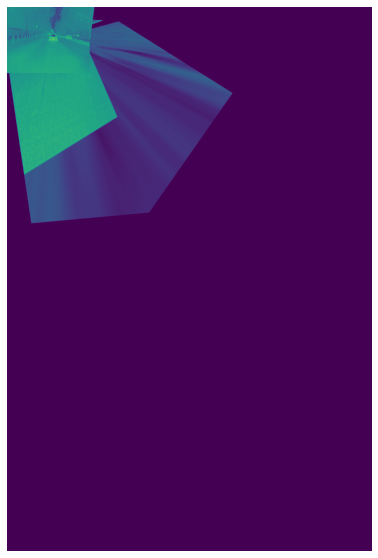

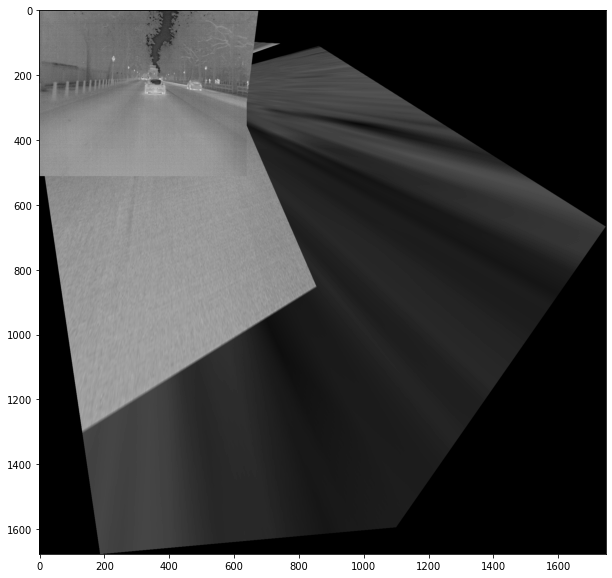

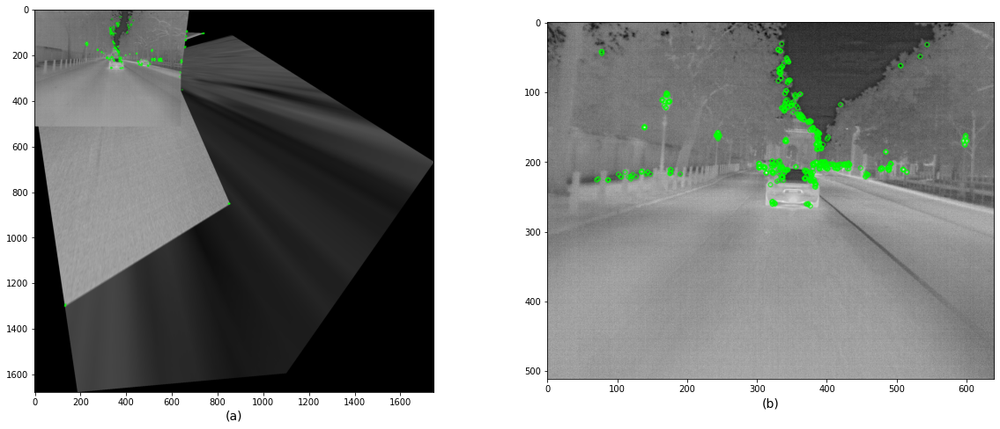

Using: bf feature matcher
Raw matches (Brute force): 122
[[ 4.38950918e-02 -3.70118964e-02  1.54319768e+02]
 [-3.77925016e-01  5.55526716e-01  1.13352756e+02]
 [-1.49682022e-03 -1.36475845e-05  1.00000000e+00]]


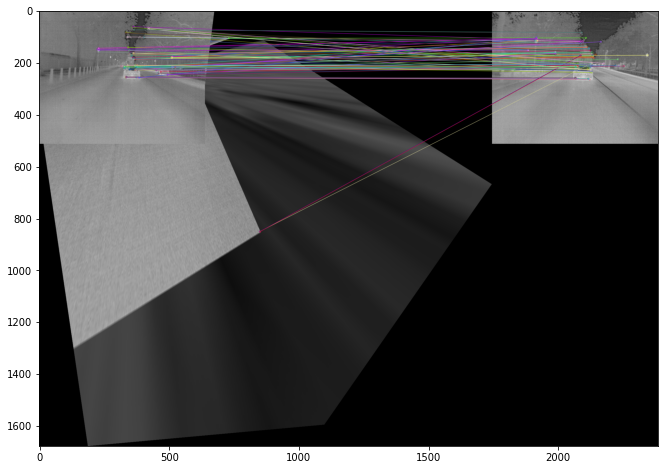

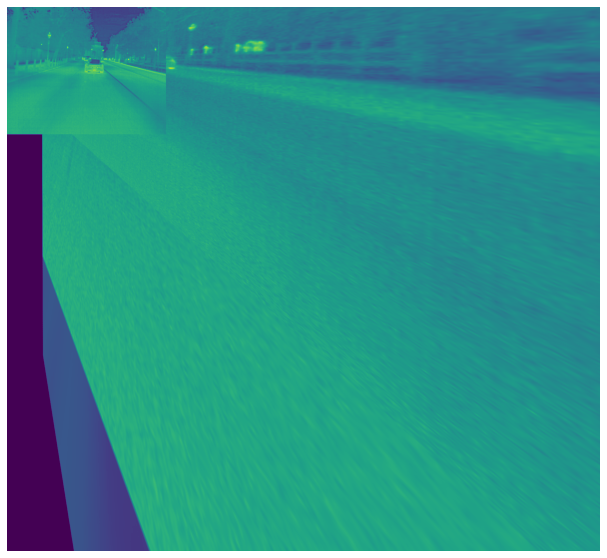

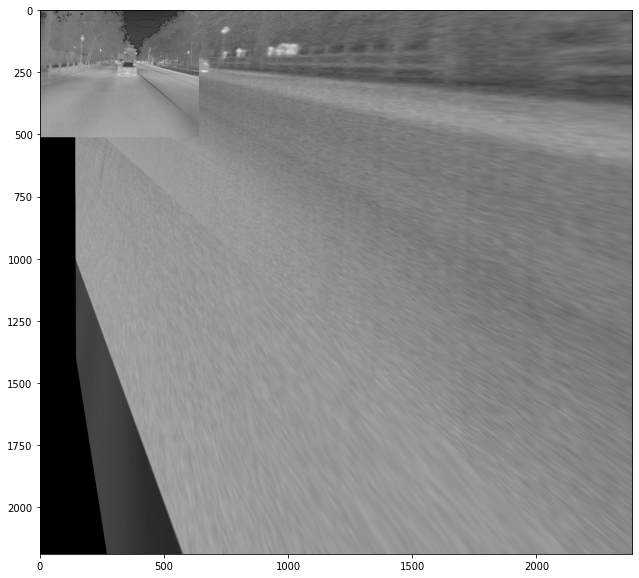

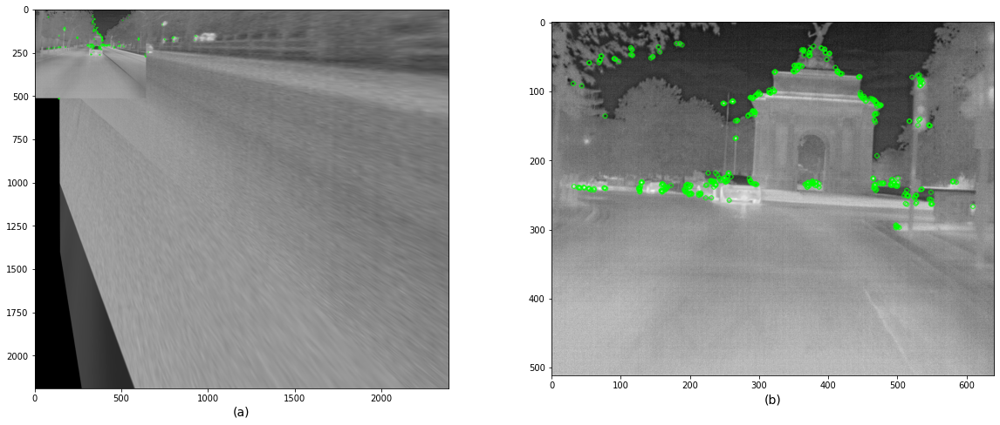

Using: bf feature matcher
Raw matches (Brute force): 130
[[-7.14397812e-01  6.33288080e-01  1.99729186e+02]
 [-7.46116027e-01  6.99694732e-01  1.81959983e+02]
 [-3.50966737e-03  2.53177325e-03  1.00000000e+00]]


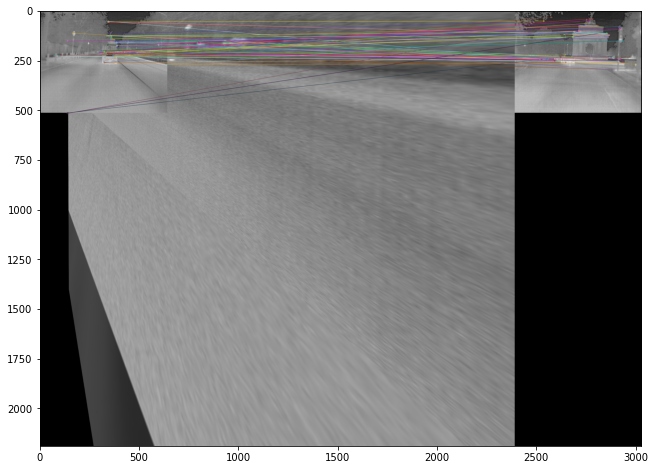

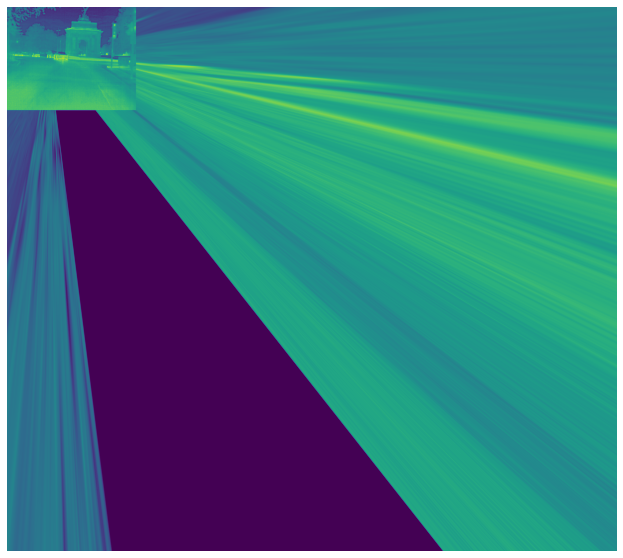

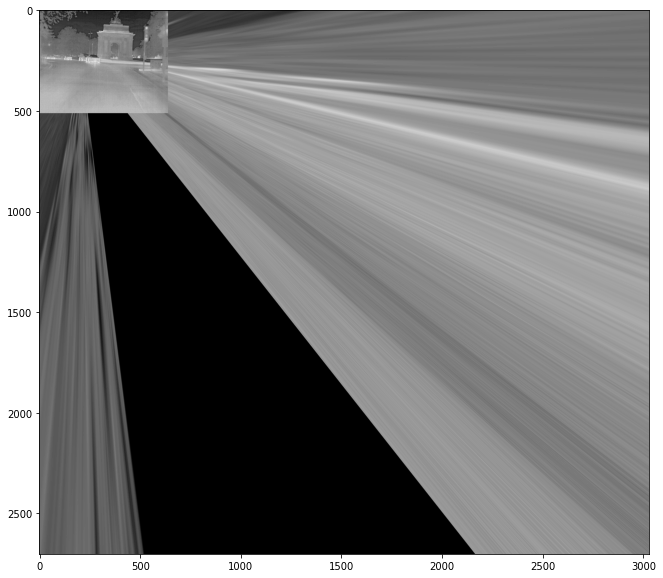

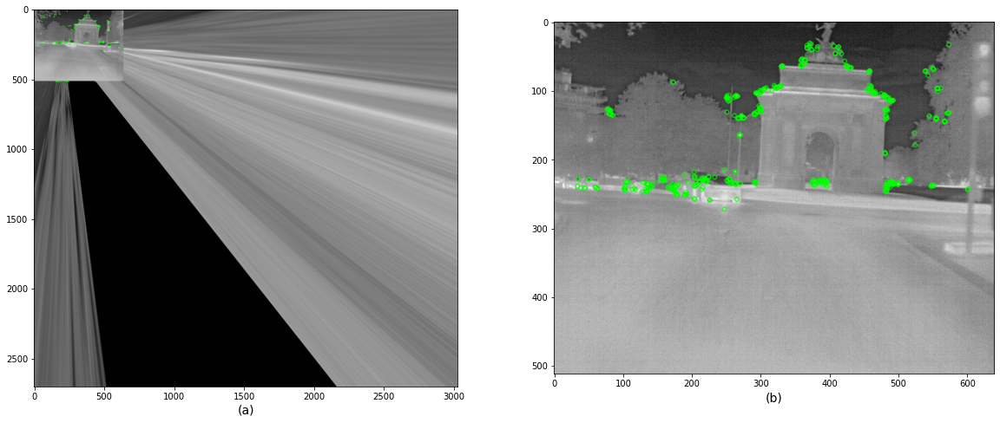

Using: bf feature matcher
Raw matches (Brute force): 206
[[ 1.04252760e+00 -2.91440639e-02 -5.54726500e+00]
 [-5.12818237e-03  1.02125379e+00 -7.43454954e+00]
 [ 1.16963250e-06 -7.61425655e-05  1.00000000e+00]]


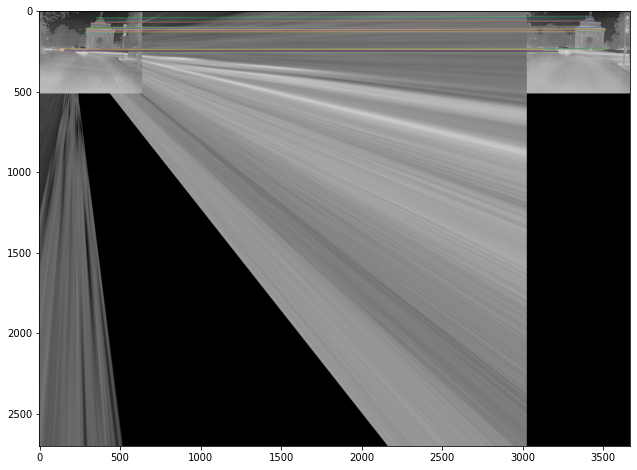

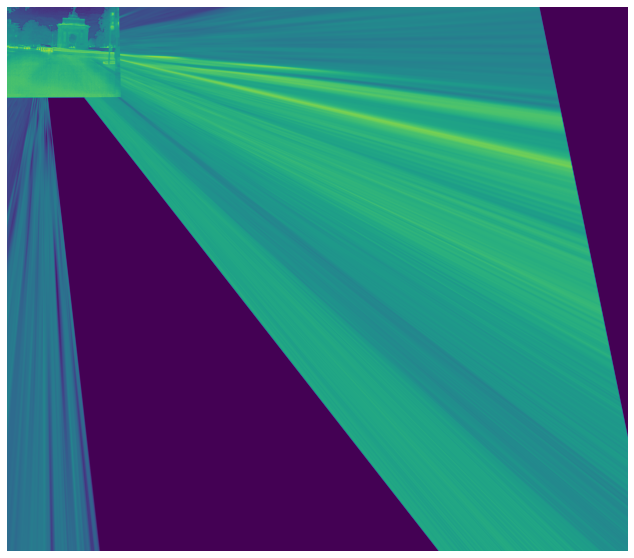

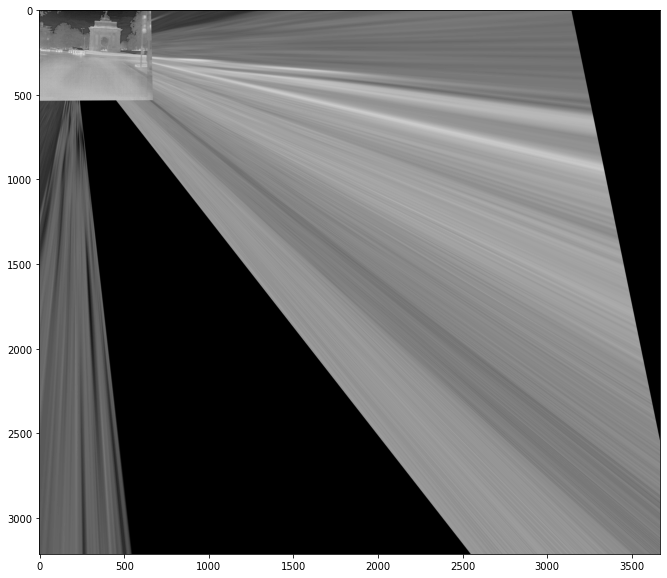

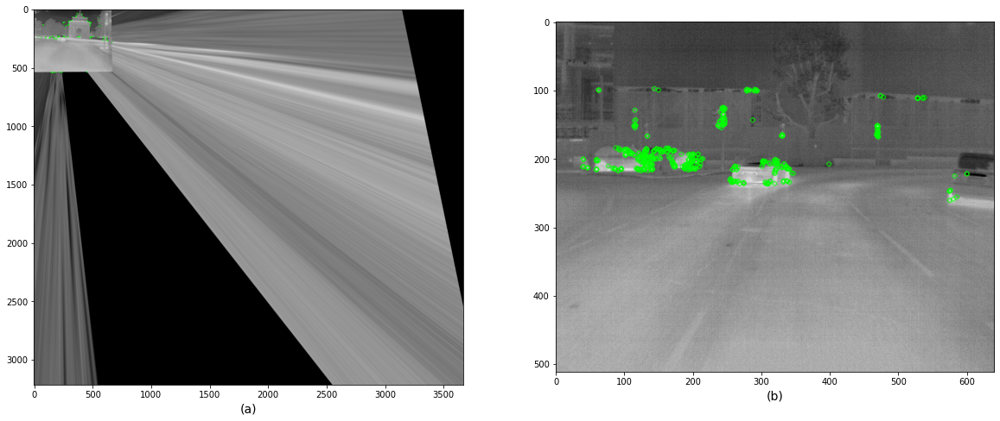

Using: bf feature matcher
Raw matches (Brute force): 116
[[ 2.71291289e+00 -7.28888140e+00  2.94630720e+02]
 [ 4.68720274e+00 -1.19349728e+01  3.49918992e+02]
 [ 2.47281442e-02 -5.93253020e-02  1.00000000e+00]]


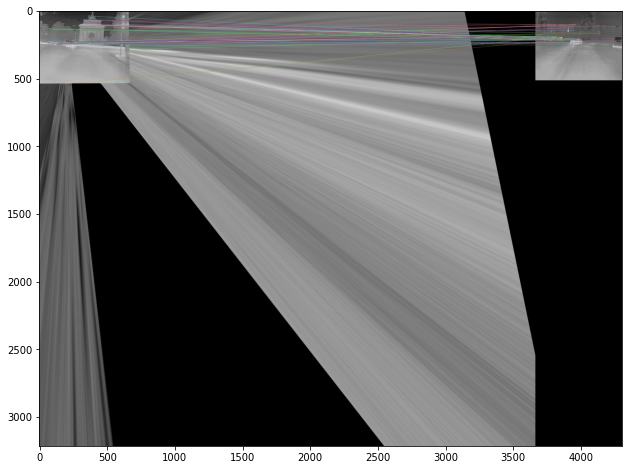

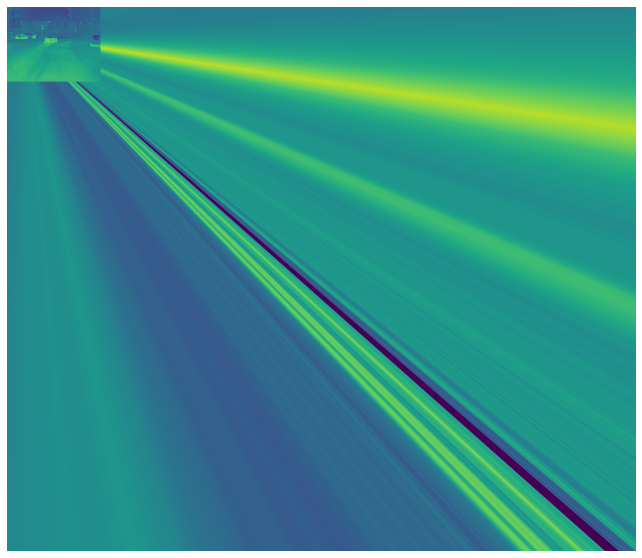

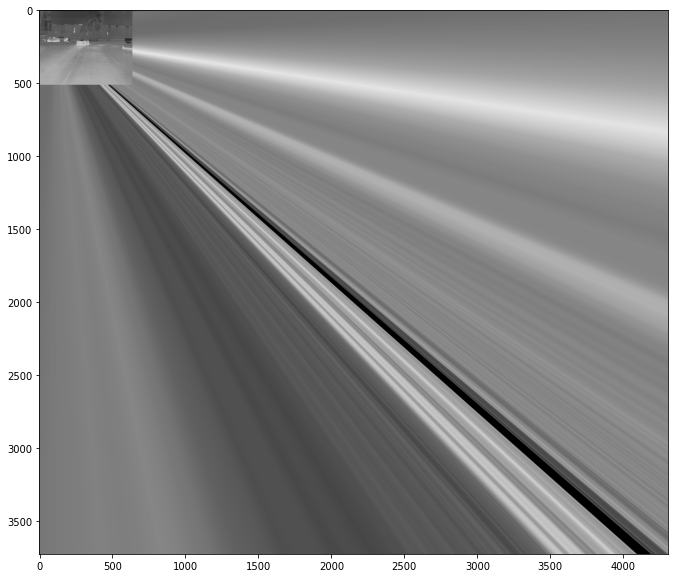

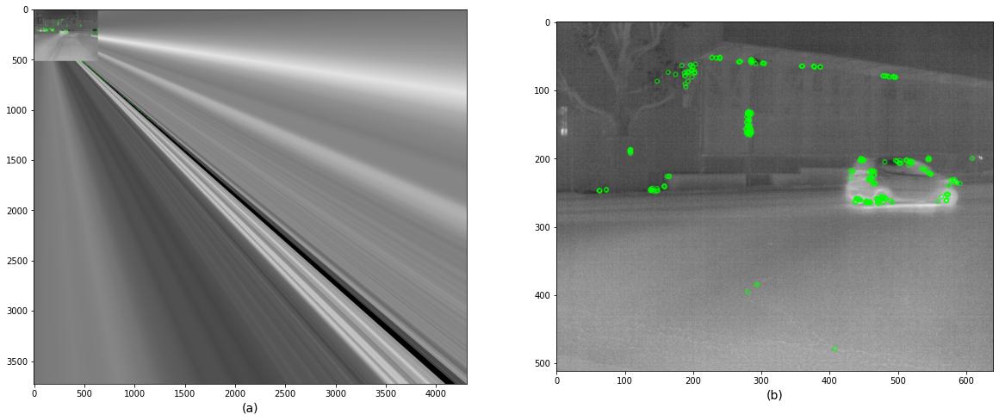

Using: bf feature matcher
Raw matches (Brute force): 96
[[-2.04640793e-01 -1.34203698e+00  2.81063510e+02]
 [-1.27855448e-01 -7.84631537e-01  1.65690299e+02]
 [-7.06340056e-04 -4.79400723e-03  1.00000000e+00]]


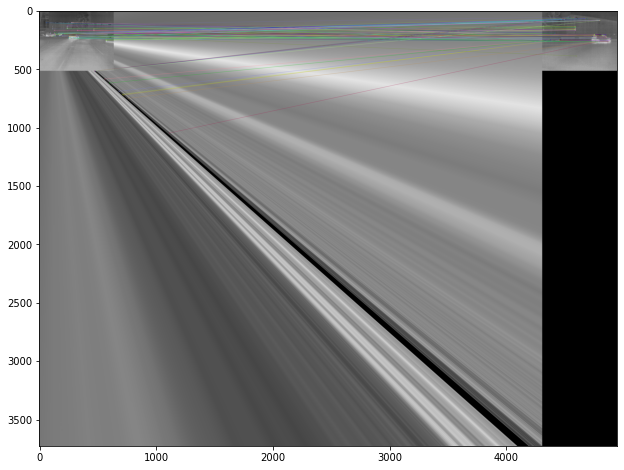

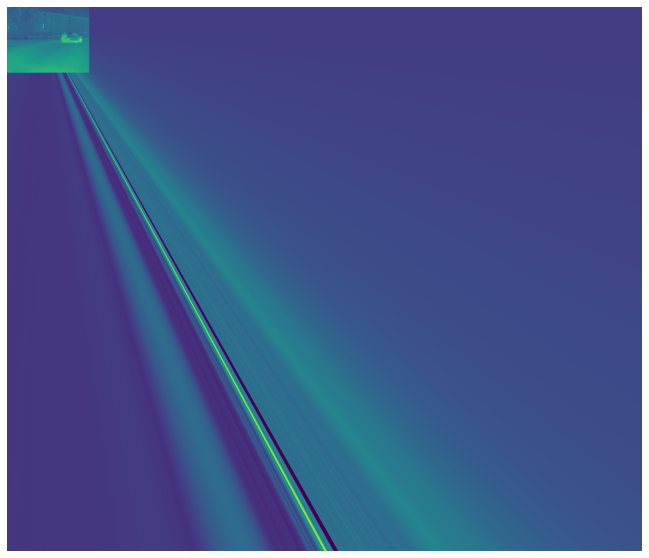

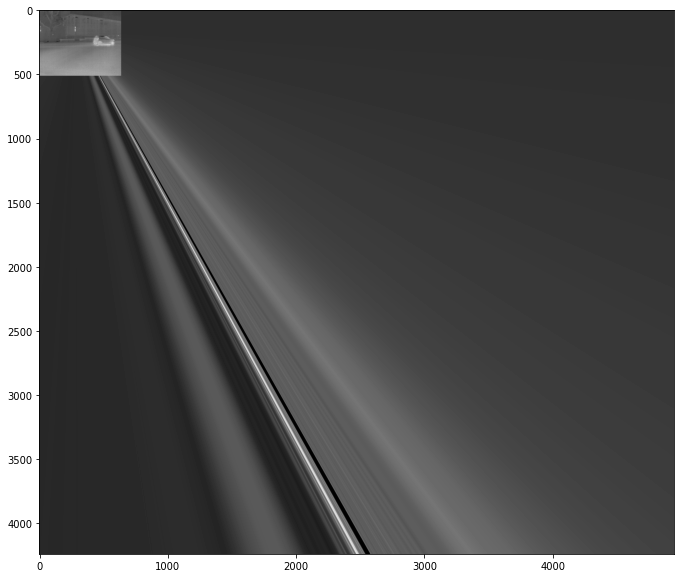

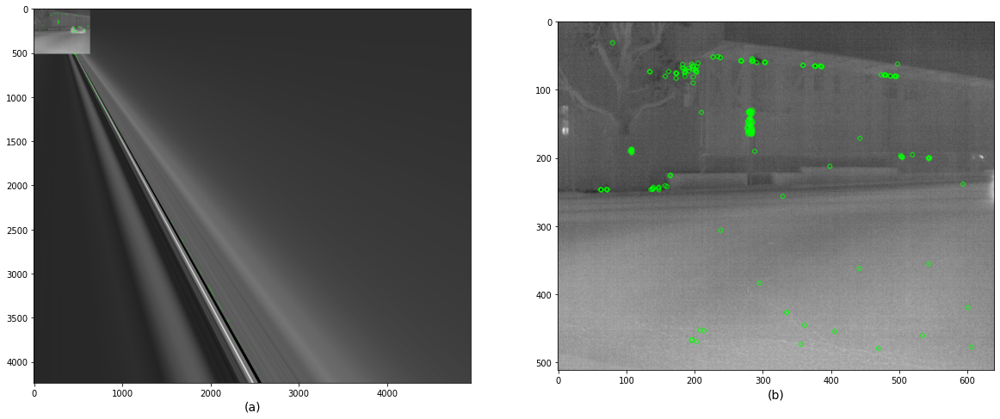

Using: bf feature matcher
Raw matches (Brute force): 101
[[ 9.98193379e-01 -1.52125880e-04  6.02988178e-02]
 [-9.23194760e-04  9.98258129e-01  4.28697782e-01]
 [-1.91757578e-06 -5.51662386e-06  1.00000000e+00]]


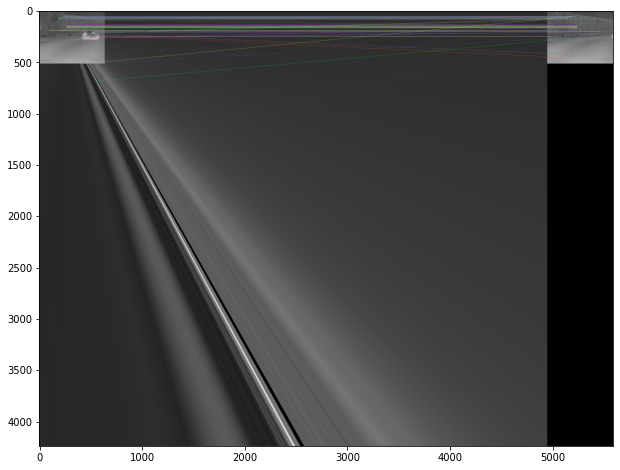

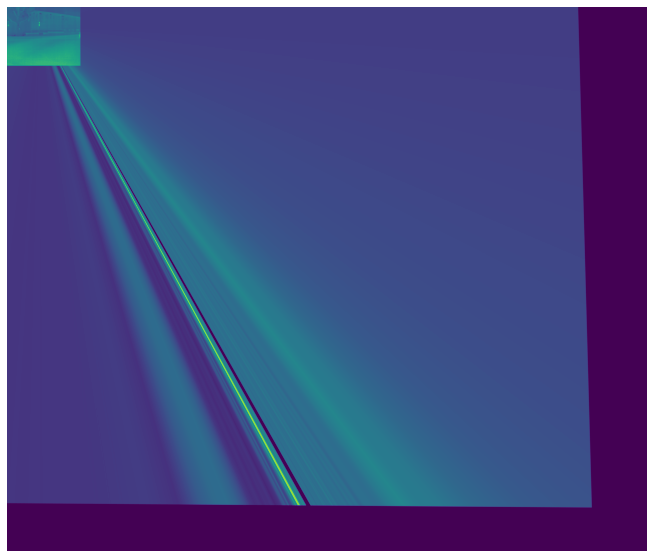

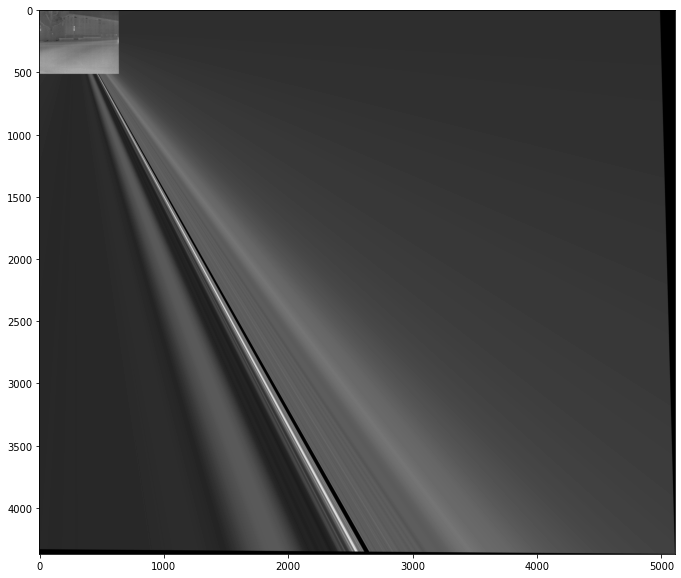

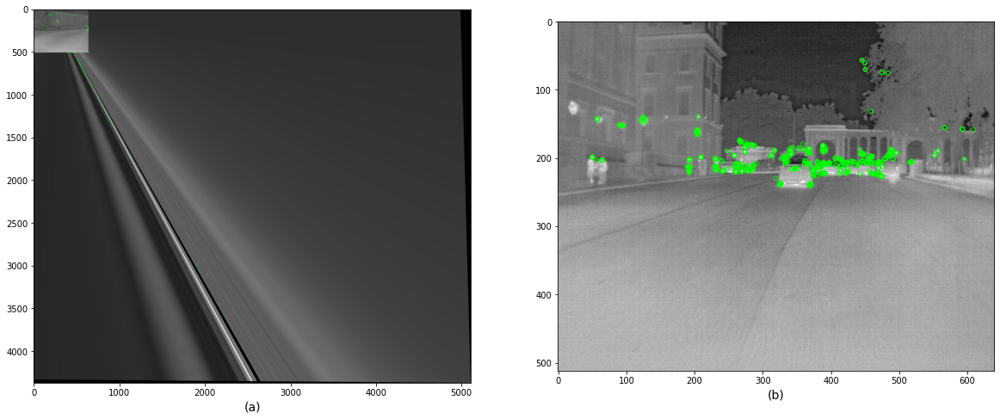

Using: bf feature matcher
Raw matches (Brute force): 103
[[-3.09748464e+00  2.85544893e+00  3.80907027e+02]
 [-1.75060080e+00  1.52312442e+00  2.20195707e+02]
 [-8.05929867e-03  7.18706388e-03  1.00000000e+00]]


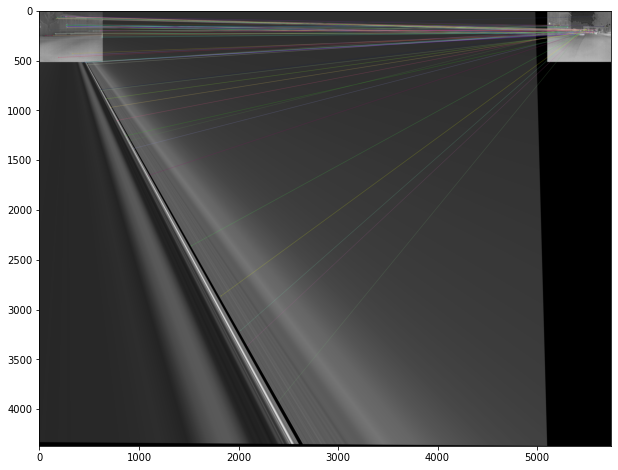

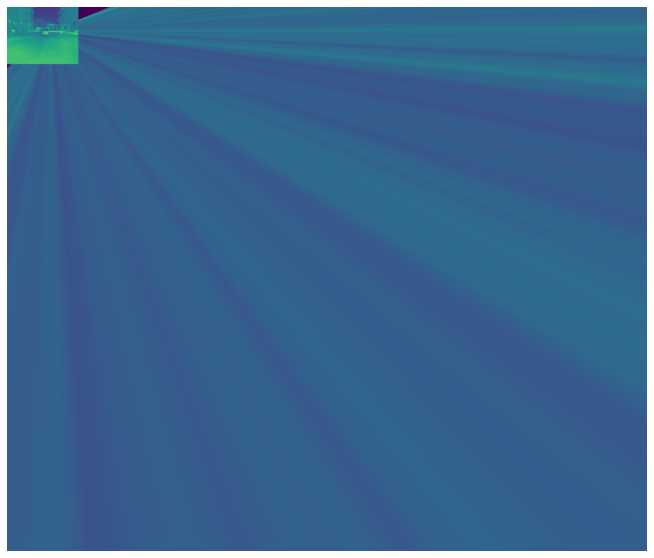

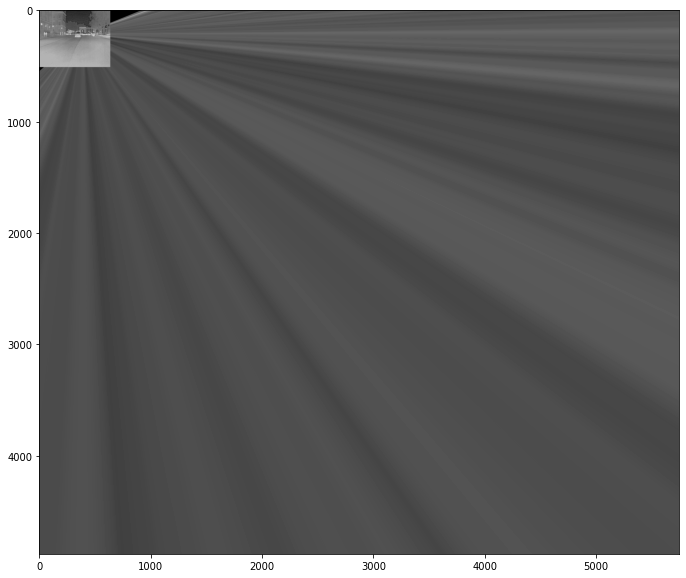

In [9]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
import imageio
import imutils
import math
import os
import numpy as np
from IPython.display import display, Markdown
from glob2 import glob

import glob
from __future__ import print_function
cv2.ocl.setUseOpenCL(False)

feature_extractor = 'orb' # one of 'brisk', 'orb'
feature_matching = 'bf'
# read images and transform them to grayscale
# Make sure that the train image is the image that will be transformed


imdir1 = '/content/drive/MyDrive/IR_sample_assignment/DP_results/FLIR_ADAS_v2_dpresults/'

ext = ['png']
files1 = []

[files1.extend(glob.glob(imdir1 + '*.' + e)) for e in ext]
files1.sort()
result=cv2.imread('/content/drive/MyDrive/IR_sample_assignment/DP_results/FLIR_ADAS_v2_dpresults/video-2rsjnZFyGQGeynfbv-frame-000826-soBCMmQ7JJiqdKRCk.png',0)
for i in range(1,len(files1)):
  trainImg_gray = result

  queryImg_gray = cv2.imread(files1[i],0)
  # Opencv defines the color channel in the order BGR. 
  # Transform it to RGB to be compatible to matplotlib

  def detectAndDescribe(image, method=None):
      """
      Compute key points and feature descriptors using an specific method
      """
      
      assert method is not None, "You need to define a feature detection method. Values are: 'sift', 'surf'"
      
      # detect and extract features from the image
      if method == 'sift':
          descriptor = cv2.xfeatures2d.SIFT_create()
      elif method == 'surf':
          descriptor = cv2.xfeatures2d.SURF_create()
      elif method == 'brisk':
          descriptor = cv2.BRISK_create()
      elif method == 'orb':
          descriptor = cv2.ORB_create()
          
      # get keypoints and descriptors
      (kps, features) = descriptor.detectAndCompute(image, None)
      
      return (kps, features)
  kpsA, featuresA = detectAndDescribe(trainImg_gray, method=feature_extractor)
  kpsB, featuresB = detectAndDescribe(queryImg_gray, method=feature_extractor)

  # display the keypoints and features detected on both images
  fig, (ax1,ax2) = plt.subplots(nrows=1, ncols=2, figsize=(20,8), constrained_layout=False)
  ax1.imshow(cv2.drawKeypoints(trainImg_gray,kpsA,None,color=(0,255,0)))
  ax1.set_xlabel("(a)", fontsize=14)
  ax2.imshow(cv2.drawKeypoints(queryImg_gray,kpsB,None,color=(0,255,0)))
  ax2.set_xlabel("(b)", fontsize=14)

  plt.show()

  def createMatcher(method,crossCheck):
      "Create and return a Matcher Object"
      
      if method == 'sift' or method == 'surf':
          bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=crossCheck)
      elif method == 'orb' or method == 'brisk':
          bf = cv2.BFMatcher(cv2.NORM_HAMMING, crossCheck=crossCheck)
      return bf

  def matchKeyPointsBF(featuresA, featuresB, method):
      bf = createMatcher(method, crossCheck=True)
          
      # Match descriptors.
      best_matches = bf.match(featuresA,featuresB)
      
      # Sort the features in order of distance.
      # The points with small distance (more similarity) are ordered first in the vector
      rawMatches = sorted(best_matches, key = lambda x:x.distance)
      print("Raw matches (Brute force):", len(rawMatches))
      return rawMatches

  def matchKeyPointsKNN(featuresA, featuresB, ratio, method):
      bf = createMatcher(method, crossCheck=False)
      # compute the raw matches and initialize the list of actual matches
      rawMatches = bf.knnMatch(featuresA, featuresB, 2)
      print("Raw matches (knn):", len(rawMatches))
      matches = []

      # loop over the raw matches
      for m,n in rawMatches:
          # ensure the distance is within a certain ratio of each
          # other (i.e. Lowe's ratio test)
          if m.distance < n.distance * ratio:
              matches.append(m)
      return matches
      
  print("Using: {} feature matcher".format(feature_matching))

  fig = plt.figure(figsize=(20,8))

  if feature_matching == 'bf':
      matches = matchKeyPointsBF(featuresA, featuresB, method=feature_extractor)
      img3 = cv2.drawMatches(trainImg_gray,kpsA,queryImg_gray,kpsB,matches[:100],
                            None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
  elif feature_matching == 'knn':
      matches = matchKeyPointsKNN(featuresA, featuresB, ratio=0.75, method=feature_extractor)
      img3 = cv2.drawMatches(trainImg_gray,kpsA,queryImg_gray,kpsB,np.random.choice(matches,100),
                            None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
      

  def getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh):
      # convert the keypoints to numpy arrays
      kpsA = np.float32([kp.pt for kp in kpsA])
      kpsB = np.float32([kp.pt for kp in kpsB])
      
      if len(matches) > 4:

          # construct the two sets of points
          ptsA = np.float32([kpsA[m.queryIdx] for m in matches])
          ptsB = np.float32([kpsB[m.trainIdx] for m in matches])
          
          # estimate the homography between the sets of points
          (H, status) = cv2.findHomography(ptsA, ptsB, cv2.RANSAC,
              reprojThresh)

          return (matches, H, status)
      else:
          return None

  M = getHomography(kpsA, kpsB, featuresA, featuresB, matches, reprojThresh=4)
  if M is None:
      print("Error!")
  (matches, H, status) = M
  print(H)
  plt.imshow(img3, cmap='gray')

  # Apply panorama correction
  width = trainImg_gray.shape[1] + queryImg_gray.shape[1]
  height = trainImg_gray.shape[0] + queryImg_gray.shape[0]

  result = cv2.warpPerspective(trainImg_gray, H, (width, height))
  result[0:queryImg_gray.shape[0], 0:queryImg_gray.shape[1]] = queryImg_gray

  plt.figure(figsize=(20,10))
  plt.imshow(result)

  plt.axis('off')
  plt.show()

  # transform the panorama image to grayscale and threshold it 
  gray = result
  thresh = cv2.threshold(gray, 0, 255, cv2.THRESH_BINARY)[1]

  # Finds contours from the binary image
  cnts = cv2.findContours(thresh.copy(), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
  cnts = imutils.grab_contours(cnts)

  # get the maximum contour area
  c = max(cnts, key=cv2.contourArea)

  # get a bbox from the contour area
  (x, y, w, h) = cv2.boundingRect(c)

  # crop the image to the bbox coordinates
  result = result[y:y + h, x:x + w]

  # show the cropped image
  plt.figure(figsize=(20,10))
  plt.imshow(result, cmap='gray')

In [11]:
cv2.imwrite("/content/drive/MyDrive/IR_sample_assignment/blending_results_DP/blended_image_FLIR_ADAS_v2.png",result)

True

Linear Blending

 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  -----------------------
   alpha :  0.5
 Simple Linear Blender
  

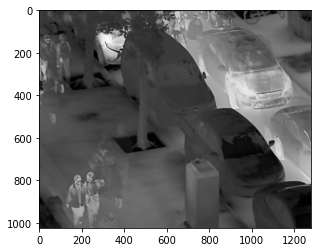

In [ ]:
import math
import cv2
import os
import matplotlib.pyplot as plt
import numpy as np
from IPython.display import display, Markdown
from glob2 import glob
import glob
from __future__ import print_function


imdir1 = '/content/drive/MyDrive/IR_sample_assignment/DP_results/LLVIP_dp_results/'

ext = ['png']
files1 = []

[files1.extend(glob.glob(imdir1 + '*.' + e)) for e in ext]
files1.sort()
output=cv2.imread('/content/drive/MyDrive/IR_sample_assignment/DP_results/LLVIP_dp_results/010018.png',0)
for i in range(1,len(files1)):
  
  gray_img = output
  gray_img2 = cv2.imread(files1[i],0)

  alpha = 0.5
  try:
      raw_input          # Python 2
  except NameError:
      raw_input = input  # Python 3
  print(''' Simple Linear Blender
  -----------------------
   alpha : ''', alpha)
  # input_alpha = float(raw_input().strip())
  # if 0 <= alpha <= 1:
  #     alpha = input_alpha
  # [load]
  src1 = gray_img
  src2 = gray_img2
  # [load]
  if src1 is None:
      print("Error loading src1")
      exit(-1)
  elif src2 is None:
      print("Error loading src2")
      exit(-1)
  # [blend_images]
  beta = (1.0 - alpha)
  output = cv2.addWeighted(src1, alpha, src2, beta, 0.0)
  # [blend_images]
  # [display]
  plt.imshow(output,cmap='gray')


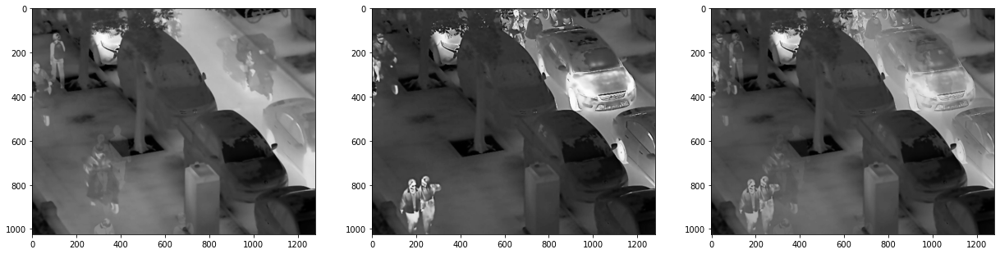

In [ ]:
plt.figure(figsize=(21, 14))
plt.subplot(1, 3, 1)
plt.imshow(gray_img, cmap='gray')
#plt.title('Original Image')

plt.subplot(1, 3, 2)
plt.imshow(gray_img2, cmap='gray')
#plt.title('Double Plateau Histogram Equalization')


plt.subplot(1, 3, 3)
plt.imshow(output, cmap='gray')
#plt.title('Double Plateau Histogram Equalization')